# **VAHA** - Visual Artwork for Human Affections

Part 3: Train cGAN. 

Below you will find process on how we trained our conditional Generative Adversarial Network.

- Preprocess Wikiart image data with csv label from Artemis
  - Preprocess the CSV file from Artemis to prepare it for further analysis. The annotated dataset created by Artemis contains duplicate data, meaning that a single painting could be associated with multiple emotional labels. Additionally, the labels used by Artemis differ from those in the FER-2013 dataset. To address these issues, we will first clean up the dataframe and then apply the appropriate labels to the images.

- Create cGAN, train cGAN
  - Our cGan is trained on Wikiart dataset with Artemis' annoted emotion labels. The generator accepts random noise and a class label as inputs, generating images conditioned on the class label. The label embedding and concatenation layers enable the generator to integrate class label information into the generated image, ensuring class-specific outputs.
  
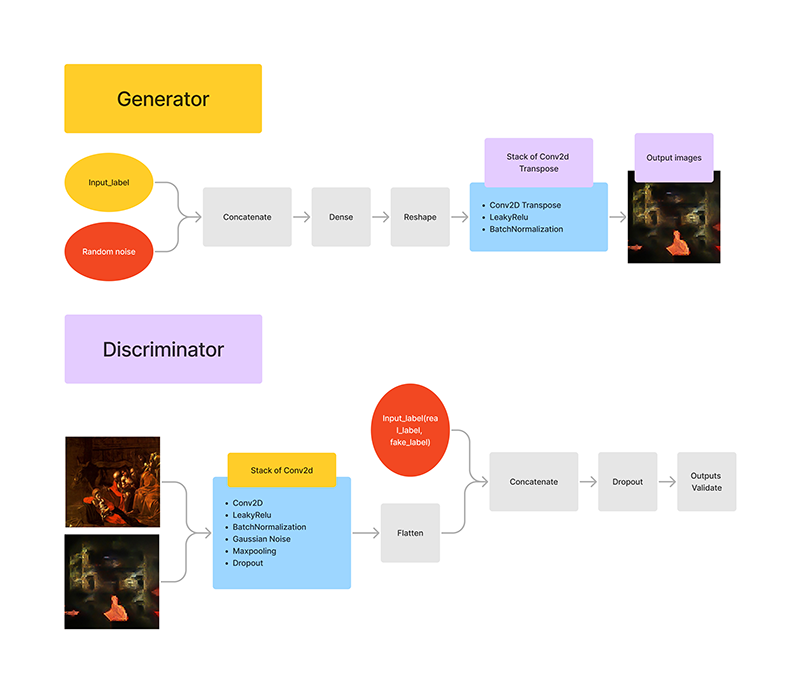
- Filtered output images 
   - The output images from our model can be highly diverse. To filter the best results, we pass all generated images through the artemis pre-trained model and select the top 3 images with the highest prediction probabilities as outputs.
   
- Denoising output images
   - Due to limited computing resources, the output images from our cGAN are 64x64x3 in size. We therefore process our output images using the denoising model to further enhance and produce high-quality images.

# Preprocess Wikiart image data with csv label from Artemis

We researched and find `artemis` dataset, which had emotional labels for all wikiart dataset.

link: https://www.artemisdataset.org/

In [ ]:
import pandas as pd
# Load CSV file into a Pandas dataframe
data = pd.read_csv('/Users/lzhan/Downloads/official_data/artemis_dataset_release_v0.csv')

In [ ]:
# Visualize the data
data

,art_style,painting,emotion,utterance,repetition
0,Post_Impressionism,vincent-van-gogh_portrait-of-madame-ginoux-l-a...,something else,"She seems very happy in the picture, and you w...",10
1,Post_Impressionism,vincent-van-gogh_portrait-of-madame-ginoux-l-a...,sadness,This woman has really knotty hands which makes...,10
2,Post_Impressionism,vincent-van-gogh_portrait-of-madame-ginoux-l-a...,something else,"When looking at this woman, I am filled with c...",10
3,Post_Impressionism,vincent-van-gogh_portrait-of-madame-ginoux-l-a...,contentment,"A woman looking at ease, peaceful, and satisfi...",10
4,Post_Impressionism,vincent-van-gogh_portrait-of-madame-ginoux-l-a...,awe,She looks like a lady from that past that migh...,10
...,...,...,...,...,...
454679,Cubism,gino-severini_a-dancer-1,awe,the collection and collage of different colors...,48
454680,Romanticism,ivan-aivazovsky_sea-at-night-1861,awe,The peaceful reflections of the moonlight on t...,8
454681,Romanticism,ivan-aivazovsky_sea-at-night-1861,excitement,I can imagine the sailors resting this peacefu...,8
454682,Romanticism,ivan-aivazovsky_sea-at-night-1861,contentment,The steep mountains and the moonlight provide ...,8


In [ ]:
# Turn dataset into a dataframe
df = pd.DataFrame(data)
df

,art_style,painting,emotion,utterance,repetition
0,Post_Impressionism,vincent-van-gogh_portrait-of-madame-ginoux-l-a...,something else,"She seems very happy in the picture, and you w...",10
1,Post_Impressionism,vincent-van-gogh_portrait-of-madame-ginoux-l-a...,sadness,This woman has really knotty hands which makes...,10
2,Post_Impressionism,vincent-van-gogh_portrait-of-madame-ginoux-l-a...,something else,"When looking at this woman, I am filled with c...",10
3,Post_Impressionism,vincent-van-gogh_portrait-of-madame-ginoux-l-a...,contentment,"A woman looking at ease, peaceful, and satisfi...",10
4,Post_Impressionism,vincent-van-gogh_portrait-of-madame-ginoux-l-a...,awe,She looks like a lady from that past that migh...,10
...,...,...,...,...,...
454679,Cubism,gino-severini_a-dancer-1,awe,the collection and collage of different colors...,48
454680,Romanticism,ivan-aivazovsky_sea-at-night-1861,awe,The peaceful reflections of the moonlight on t...,8
454681,Romanticism,ivan-aivazovsky_sea-at-night-1861,excitement,I can imagine the sailors resting this peacefu...,8
454682,Romanticism,ivan-aivazovsky_sea-at-night-1861,contentment,The steep mountains and the moonlight provide ...,8


In [ ]:
# Check out the 'emotion' column in the dataframe
df['emotion'].describe()

count          454684
unique              9
top       contentment
freq           126134
Name: emotion, dtype: object

## Check if the file in `artemis` is exist in the `wiki-art` dataset, if not just delete the row.

Because we downloaded our Wikiart dataset from Kaggle, it may not be the same dataset as Artemis used. So we will check and filtered out the files that doesn't exist on our dataset below.

In [ ]:
import os
data_dir = '/Users/lzhan/Downloads/wiki-art/'
def check_image_exists(row):
    folder = row['art_style']
    image_file = row['painting']
    image_path = os.path.join(data_dir + folder, image_file + '.jpg')
    print(image_path)
    return os.path.exists(image_path)

In [ ]:
# Apply the function to each row and store the result in a new column 'image_exists'
df['image_exists'] = df.apply(check_image_exists, axis=1)

/Users/lzhan/Downloads/wiki-art/Post_Impressionism\vincent-van-gogh_portrait-of-madame-ginoux-l-arlesienne-1890.jpg
/Users/lzhan/Downloads/wiki-art/Post_Impressionism\vincent-van-gogh_portrait-of-madame-ginoux-l-arlesienne-1890.jpg
/Users/lzhan/Downloads/wiki-art/Post_Impressionism\vincent-van-gogh_portrait-of-madame-ginoux-l-arlesienne-1890.jpg
/Users/lzhan/Downloads/wiki-art/Post_Impressionism\vincent-van-gogh_portrait-of-madame-ginoux-l-arlesienne-1890.jpg
/Users/lzhan/Downloads/wiki-art/Post_Impressionism\vincent-van-gogh_portrait-of-madame-ginoux-l-arlesienne-1890.jpg
/Users/lzhan/Downloads/wiki-art/Expressionism\wassily-kandinsky_study-for-autumn-1909.jpg
/Users/lzhan/Downloads/wiki-art/Expressionism\wassily-kandinsky_study-for-autumn-1909.jpg
/Users/lzhan/Downloads/wiki-art/Impressionism\konstantin-korovin_yaroslavna-s-lament-1909.jpg
/Users/lzhan/Downloads/wiki-art/Impressionism\konstantin-korovin_yaroslavna-s-lament-1909.jpg
/Users/lzhan/Downloads/wiki-art/Impressionism\paul-g

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



/Users/lzhan/Downloads/wiki-art/Realism\henri-fantin-latour_roses-and-nasturtiums.jpg
/Users/lzhan/Downloads/wiki-art/Baroque\joseph-wright_the-prisoner.jpg
/Users/lzhan/Downloads/wiki-art/Romanticism\gustave-dore_don-quixote-16.jpg
/Users/lzhan/Downloads/wiki-art/Realism\frederic-remington_a-misdeal-1897.jpg
/Users/lzhan/Downloads/wiki-art/Post_Impressionism\maurice-utrillo_basilica-of-st-denis-1.jpg
/Users/lzhan/Downloads/wiki-art/Naive_Art_Primitivism\salvador-dali_decalcomania.jpg
/Users/lzhan/Downloads/wiki-art/Art_Nouveau_Modern\koloman-moser_three-women-squatting.jpg
/Users/lzhan/Downloads/wiki-art/Realism\henri-fantin-latour_flowers-large-bouquet-with-three-peonies-1879.jpg
/Users/lzhan/Downloads/wiki-art/Symbolism\martiros-saryan_piping-shepherd-1904.jpg
/Users/lzhan/Downloads/wiki-art/Impressionism\childe-hassam_sailing-ship-locked-in-ice-1.jpg
/Users/lzhan/Downloads/wiki-art/Impressionism\childe-hassam_messenger-boy.jpg
/Users/lzhan/Downloads/wiki-art/Romanticism\gustave-dor

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



/Users/lzhan/Downloads/wiki-art/Romanticism\cornelis-springer_cityview-wiith-marketstall.jpg
/Users/lzhan/Downloads/wiki-art/Color_Field_Painting\helen-frankenthaler_sanguine-mood-1971.jpg
/Users/lzhan/Downloads/wiki-art/Romanticism\cornelis-springer_along-the-canal-1862.jpg
/Users/lzhan/Downloads/wiki-art/Baroque\bartolome-esteban-murillo_a-young-man-with-a-basket-of-fruit-1640.jpg
/Users/lzhan/Downloads/wiki-art/Rococo\francois-boucher_seated-nude-1738.jpg
/Users/lzhan/Downloads/wiki-art/Symbolism\gustav-klimt_mada-primavesi.jpg
/Users/lzhan/Downloads/wiki-art/Naive_Art_Primitivism\grã©goire-michonze_sunset-in-the-field-1979.jpg
/Users/lzhan/Downloads/wiki-art/Color_Field_Painting\gotthard-graubner_sarda-i-2001.jpg
/Users/lzhan/Downloads/wiki-art/Cubism\gosta-adrian-nilsson_jack-1915.jpg
/Users/lzhan/Downloads/wiki-art/Expressionism\arturo-souto_still-life-1957.jpg
/Users/lzhan/Downloads/wiki-art/Post_Impressionism\david-burliuk_still-life-with-flowers-by-the-sea-1948.jpg
/Users/lzha

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



/Users/lzhan/Downloads/wiki-art/Impressionism\camille-pissarro_the-railroad-bridge-at-bedford-park-1.jpg
/Users/lzhan/Downloads/wiki-art/Romanticism\gustave-dore_enthusiasm-of-crusaders-at-the-first-view-of-jerusalem.jpg
/Users/lzhan/Downloads/wiki-art/Romanticism\gheorghe-tattarescu_laz-r-kalinderu.jpg
/Users/lzhan/Downloads/wiki-art/Art_Nouveau_Modern\nicholas-roerich_old-town-1902.jpg
/Users/lzhan/Downloads/wiki-art/Naive_Art_Primitivism\viorel-marginean_peisaj-2009.jpg
/Users/lzhan/Downloads/wiki-art/Impressionism\childe-hassam_the-east-headland-appledore-isles-of-shoals.jpg
/Users/lzhan/Downloads/wiki-art/Expressionism\frank-auerbach_bacchus-and-ariadne.jpg
/Users/lzhan/Downloads/wiki-art/Expressionism\jackson-pollock_sheet-of-studies-1941(1).jpg
/Users/lzhan/Downloads/wiki-art/Romanticism\henry-raeburn_john-home.jpg
/Users/lzhan/Downloads/wiki-art/Abstract_Expressionism\willem-de-kooning_mae-west.jpg
/Users/lzhan/Downloads/wiki-art/Expressionism\frantisek-kupka_front-cover-of-the

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



/Users/lzhan/Downloads/wiki-art/Minimalism\sol-lewitt_summer-collage-1981.jpg
/Users/lzhan/Downloads/wiki-art/Impressionism\alfred-sisley_the-forest-at-boulogne.jpg
/Users/lzhan/Downloads/wiki-art/Synthetic_Cubism\juan-gris_guitar-bottle-and-glass-1914.jpg
/Users/lzhan/Downloads/wiki-art/Color_Field_Painting\gene-davis_midnight-watch-1976.jpg
/Users/lzhan/Downloads/wiki-art/Symbolism\felicien-rops_the-trifles-of-the-door.jpg
/Users/lzhan/Downloads/wiki-art/Color_Field_Painting\friedel-dzubas_red-split.jpg
/Users/lzhan/Downloads/wiki-art/Realism\boris-kustodiev_portrait-of-the-artist-tatiana-chizhova-1924.jpg
/Users/lzhan/Downloads/wiki-art/Color_Field_Painting\jose-guerrero_untitled-1985-1.jpg
/Users/lzhan/Downloads/wiki-art/Minimalism\richard-serra_chunk-1967.jpg
/Users/lzhan/Downloads/wiki-art/Minimalism\ellsworth-kelly_sculpture-for-a-large-wall-1957.jpg
/Users/lzhan/Downloads/wiki-art/Rococo\joseph-wright_thomas-day.jpg
/Users/lzhan/Downloads/wiki-art/Color_Field_Painting\ad-reinha

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



/Users/lzhan/Downloads/wiki-art/Realism\vincent-van-gogh_woman-sewing-1881.jpg
/Users/lzhan/Downloads/wiki-art/Realism\vincent-van-gogh_woman-sewing-1881.jpg
/Users/lzhan/Downloads/wiki-art/Realism\vincent-van-gogh_woman-sewing-1881.jpg
/Users/lzhan/Downloads/wiki-art/Romanticism\vasily-tropinin_portrait-of-a-a-sannikov-1823.jpg
/Users/lzhan/Downloads/wiki-art/Romanticism\vasily-tropinin_portrait-of-a-a-sannikov-1823.jpg
/Users/lzhan/Downloads/wiki-art/Romanticism\vasily-tropinin_portrait-of-a-a-sannikov-1823.jpg
/Users/lzhan/Downloads/wiki-art/Romanticism\taras-shevchenko_the-gypsy-fortune-teller-1841.jpg
/Users/lzhan/Downloads/wiki-art/Romanticism\taras-shevchenko_the-gypsy-fortune-teller-1841.jpg
/Users/lzhan/Downloads/wiki-art/Romanticism\taras-shevchenko_the-gypsy-fortune-teller-1841.jpg
/Users/lzhan/Downloads/wiki-art/Realism\thomas-eakins_eakins-perspective-study-of-boy-viewing-object-1910.jpg
/Users/lzhan/Downloads/wiki-art/Realism\thomas-eakins_eakins-perspective-study-of-boy-

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



/Users/lzhan/Downloads/wiki-art/Impressionism\john-singer-sargent_elsie-palmer.jpg
/Users/lzhan/Downloads/wiki-art/Impressionism\nikolay-bogdanov-belsky_boy-on-a-grass.jpg
/Users/lzhan/Downloads/wiki-art/Romanticism\william-turner_mortlake-terrace.jpg
/Users/lzhan/Downloads/wiki-art/Expressionism\rafael-zabaleta_harlequin-and-clown-with-mask-1942.jpg
/Users/lzhan/Downloads/wiki-art/Romanticism\orest-kiprensky_portrait-of-ivan-aleksandrovich-annenkov.jpg
/Users/lzhan/Downloads/wiki-art/Impressionism\john-henry-twachtman_snow-scene.jpg
/Users/lzhan/Downloads/wiki-art/Impressionism\john-henry-twachtman_last-touch-of-sun.jpg
/Users/lzhan/Downloads/wiki-art/Realism\vasily-surikov_portrait-of-i-s-ostroukhov-1884.jpg
/Users/lzhan/Downloads/wiki-art/Realism\vladimir-makovsky_the-doss-house-1889.jpg
/Users/lzhan/Downloads/wiki-art/Expressionism\zinaida-serebriakova_self-portrait-1938.jpg
/Users/lzhan/Downloads/wiki-art/Impressionism\maxime-maufra_the-old-bridge-in-barbin-1884.jpg
/Users/lzhan/D

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



/Users/lzhan/Downloads/wiki-art/Art_Nouveau_Modern\tom-thomson_woodland-waterfall-1916.jpg
/Users/lzhan/Downloads/wiki-art/Romanticism\john-constable_golding-constable-s-kitchen-garden-1815.jpg
/Users/lzhan/Downloads/wiki-art/Romanticism\john-constable_golding-constable-s-kitchen-garden-1815.jpg
/Users/lzhan/Downloads/wiki-art/Romanticism\john-constable_golding-constable-s-kitchen-garden-1815.jpg
/Users/lzhan/Downloads/wiki-art/Romanticism\john-constable_golding-constable-s-kitchen-garden-1815.jpg
/Users/lzhan/Downloads/wiki-art/Romanticism\john-constable_golding-constable-s-kitchen-garden-1815.jpg
/Users/lzhan/Downloads/wiki-art/Romanticism\john-constable_golding-constable-s-kitchen-garden-1815.jpg
/Users/lzhan/Downloads/wiki-art/Romanticism\john-constable_golding-constable-s-kitchen-garden-1815.jpg
/Users/lzhan/Downloads/wiki-art/Romanticism\john-constable_golding-constable-s-kitchen-garden-1815.jpg
/Users/lzhan/Downloads/wiki-art/Romanticism\john-constable_golding-constable-s-kitche

In [ ]:
# Keep only rows where 'image_exists' is True
df_filtered = df[df['image_exists']]

# Drop the 'image_exists' column as it's no longer needed
df_filtered = df_filtered.drop(columns='image_exists')

In [ ]:
# Check our df after filtered
df_filtered

,art_style,painting,emotion,utterance,repetition
0,Post_Impressionism,vincent-van-gogh_portrait-of-madame-ginoux-l-a...,something else,"She seems very happy in the picture, and you w...",10
1,Post_Impressionism,vincent-van-gogh_portrait-of-madame-ginoux-l-a...,sadness,This woman has really knotty hands which makes...,10
2,Post_Impressionism,vincent-van-gogh_portrait-of-madame-ginoux-l-a...,something else,"When looking at this woman, I am filled with c...",10
3,Post_Impressionism,vincent-van-gogh_portrait-of-madame-ginoux-l-a...,contentment,"A woman looking at ease, peaceful, and satisfi...",10
4,Post_Impressionism,vincent-van-gogh_portrait-of-madame-ginoux-l-a...,awe,She looks like a lady from that past that migh...,10
...,...,...,...,...,...
454679,Cubism,gino-severini_a-dancer-1,awe,the collection and collage of different colors...,48
454680,Romanticism,ivan-aivazovsky_sea-at-night-1861,awe,The peaceful reflections of the moonlight on t...,8
454681,Romanticism,ivan-aivazovsky_sea-at-night-1861,excitement,I can imagine the sailors resting this peacefu...,8
454682,Romanticism,ivan-aivazovsky_sea-at-night-1861,contentment,The steep mountains and the moonlight provide ...,8


## Split contents under `contentment` into other class to make a balance dataset
Through out our experiments, we noticed inbalanced labeled in the dataset. In order to let GAN performs the best, we decide to split contents under `contentment` into other classes

In [ ]:
import numpy as np
import pandas as pd

def split_contentment(df):
    # Calculate the difference between the 'contentment' class and other classes
    contentment_diff = df['emotion'].value_counts()['contentment'] - df['emotion'].value_counts().mean()
    
    # Calculate the ratio for each class
    classes = df['emotion'].unique().tolist()
    classes.remove('contentment')
    ratios = [1/len(classes)] * len(classes)
    
    # Create a new dataframe with split contentment class
    new_df = df.copy()
    contentment_df = df[df['emotion'] == 'contentment']
    contentment_df = contentment_df.reset_index(drop=True)
    
    start_idx = 0
    for i, class_name in enumerate(classes):
        num_split = int(contentment_diff * ratios[i])
        contentment_df.loc[start_idx:start_idx + num_split - 1, 'emotion'] = class_name
        start_idx += num_split
    
    num_anger = len(contentment_df) // 2
    num_disgust = len(contentment_df) - num_anger
    contentment_df.loc[:num_anger - 1, 'emotion'] = 'anger'
    contentment_df.loc[num_anger:, 'emotion'] = 'disgust'
    # Drop the old contentment class from the original dataframe and append the new split contentment class
    new_df = new_df[new_df['emotion'] != 'contentment']
    new_df = pd.concat([new_df, contentment_df], ignore_index=True)

    return new_df

df_filtered = split_contentment(df_filtered)

In [ ]:
# Check our df after filtered
df_filtered

,art_style,painting,emotion,utterance,repetition
0,Post_Impressionism,vincent-van-gogh_portrait-of-madame-ginoux-l-a...,something else,"She seems very happy in the picture, and you w...",10
1,Post_Impressionism,vincent-van-gogh_portrait-of-madame-ginoux-l-a...,sadness,This woman has really knotty hands which makes...,10
2,Post_Impressionism,vincent-van-gogh_portrait-of-madame-ginoux-l-a...,something else,"When looking at this woman, I am filled with c...",10
3,Post_Impressionism,vincent-van-gogh_portrait-of-madame-ginoux-l-a...,awe,She looks like a lady from that past that migh...,10
4,Expressionism,wassily-kandinsky_study-for-autumn-1909,awe,The bright colors make a very unique scene for...,7
...,...,...,...,...,...
450550,Impressionism,konstantin-korovin_paris-1906,disgust,The city seems crowded with the darkness and s...,49
450551,Impressionism,konstantin-korovin_paris-1906,disgust,"I feel comforted by somber scenes. the rainy, ...",49
450552,Impressionism,konstantin-korovin_paris-1906,disgust,it reminds me of a cold morining looking out o...,49
450553,Mannerism_Late_Renaissance,el-greco_st-francis-and-brother-leo-meditating...,disgust,I like the mystery here in the way i wonder wh...,50


## check what emotion labels we have under the emotion column

In [ ]:
df_filtered['emotion'].value_counts()

disgust           84711
awe               72234
anger             69073
something else    52612
sadness           48617
amusement         44913
fear              41197
excitement        37198
Name: emotion, dtype: int64

For the emotion detection we did in other model, we use FER-2013 dataset. In order to match them, we need to make some adjustment. 

In the FER-2013 dataset, we have the following emotion labels: 
    
- angry
- disgusted
- fearful
- happy
- neutral
- sad 
- surprised

We will update the labels base on their literal meaning.

In [ ]:
df_filtered['emotion'] = df_filtered['emotion'].replace('awe', 'surprised')
df_filtered['emotion'].value_counts()

disgust           84711
surprised         72234
anger             69073
something else    52612
sadness           48617
amusement         44913
fear              41197
excitement        37198
Name: emotion, dtype: int64

In [ ]:
df_filtered['emotion'] = df_filtered['emotion'].replace('something else', 'neutral')
df_filtered['emotion'].value_counts()

disgust       84711
surprised     72234
anger         69073
neutral       52612
sadness       48617
amusement     44913
fear          41197
excitement    37198
Name: emotion, dtype: int64

In [ ]:
df_filtered['emotion'] = df_filtered['emotion'].replace('anger', 'angry')
df_filtered['emotion'] = df_filtered['emotion'].replace('fear', 'fearful')
df_filtered['emotion'] = df_filtered['emotion'].replace('disgust', 'disgusted')
df_filtered['emotion'] = df_filtered['emotion'].replace('sadness', 'sad')
df_filtered['emotion'] = df_filtered['emotion'].replace(['excitement', 'amusement'], 'happy')
df_filtered['emotion'].value_counts()

disgusted    84711
happy        82111
surprised    72234
angry        69073
neutral      52612
sad          48617
fearful      41197
Name: emotion, dtype: int64

## Applying file path for each artwork in a new column

In [ ]:
df_filtered['file_path'] = df_filtered.apply(lambda row: os.path.join(data_dir + row['art_style'] + '/', row['painting'] + '.jpg'), axis=1)
df_filtered

,art_style,painting,emotion,utterance,repetition,file_path
0,Post_Impressionism,vincent-van-gogh_portrait-of-madame-ginoux-l-a...,neutral,"She seems very happy in the picture, and you w...",10,/Users/lzhan/Downloads/wiki-art/Post_Impressio...
1,Post_Impressionism,vincent-van-gogh_portrait-of-madame-ginoux-l-a...,sad,This woman has really knotty hands which makes...,10,/Users/lzhan/Downloads/wiki-art/Post_Impressio...
2,Post_Impressionism,vincent-van-gogh_portrait-of-madame-ginoux-l-a...,neutral,"When looking at this woman, I am filled with c...",10,/Users/lzhan/Downloads/wiki-art/Post_Impressio...
3,Post_Impressionism,vincent-van-gogh_portrait-of-madame-ginoux-l-a...,surprised,She looks like a lady from that past that migh...,10,/Users/lzhan/Downloads/wiki-art/Post_Impressio...
4,Expressionism,wassily-kandinsky_study-for-autumn-1909,surprised,The bright colors make a very unique scene for...,7,/Users/lzhan/Downloads/wiki-art/Expressionism/...
...,...,...,...,...,...,...
450550,Impressionism,konstantin-korovin_paris-1906,disgusted,The city seems crowded with the darkness and s...,49,/Users/lzhan/Downloads/wiki-art/Impressionism/...
450551,Impressionism,konstantin-korovin_paris-1906,disgusted,"I feel comforted by somber scenes. the rainy, ...",49,/Users/lzhan/Downloads/wiki-art/Impressionism/...
450552,Impressionism,konstantin-korovin_paris-1906,disgusted,it reminds me of a cold morining looking out o...,49,/Users/lzhan/Downloads/wiki-art/Impressionism/...
450553,Mannerism_Late_Renaissance,el-greco_st-francis-and-brother-leo-meditating...,disgusted,I like the mystery here in the way i wonder wh...,50,/Users/lzhan/Downloads/wiki-art/Mannerism_Late...


# Check if there's duplicated file, if yes filtered it

In Artemis' research, one painting has more than 1 emotional labels. We will filtered it out by randomly select the label

In [ ]:
df_filtered.duplicated(subset='painting').sum()

371281

filtered out duplicated images by randomly selected the label

In [ ]:
import random

def select_label(emotions):
    i = random.randint(0, 3)
    return emotions.iloc[i]


# Custom aggregation function to select the first value for other columns
def select_first(values):
    return values.iloc[0]

# Group by painting and aggregate using the custom functions
df_filtered_1 = df_filtered.groupby('painting', as_index=False).agg({
    'art_style': select_first,
    'emotion': select_label,
    'utterance': select_first,
    'repetition': select_first,
    'file_path': select_first
})

df_filtered_1

,painting,art_style,emotion,utterance,repetition,file_path
0,a.y.-jackson_algoma-in-november-1935,Art_Nouveau_Modern,fearful,cannot cross the wide river,5,/Users/lzhan/Downloads/wiki-art/Art_Nouveau_Mo...
1,a.y.-jackson_barns-1926,Post_Impressionism,angry,A scenery depicted with perfection.,5,/Users/lzhan/Downloads/wiki-art/Post_Impressio...
2,a.y.-jackson_early-spring-quebec-1923,Post_Impressionism,sad,Orange home situated atop a hill with horse an...,5,/Users/lzhan/Downloads/wiki-art/Post_Impressio...
3,a.y.-jackson_entrance-to-halifax-harbour-1919,Post_Impressionism,disgusted,A terrible landscape. It almost seems like som...,5,/Users/lzhan/Downloads/wiki-art/Post_Impressio...
4,a.y.-jackson_first-snow-algoma-country-1920,Art_Nouveau_Modern,fearful,I feel sadness because it appears that everyth...,5,/Users/lzhan/Downloads/wiki-art/Art_Nouveau_Mo...
...,...,...,...,...,...,...
79269,zinaida-serebriakova_work-from-collioure-1930,Expressionism,happy,This boy looks too hot with his red cheeks and...,5,/Users/lzhan/Downloads/wiki-art/Expressionism/...
79270,zinaida-serebriakova_yevgeny-lanceray-in-a-sha...,Expressionism,happy,The man's hat looks like it's been constructed...,5,/Users/lzhan/Downloads/wiki-art/Expressionism/...
79271,zinaida-serebriakova_young-breton-1934,Expressionism,disgusted,The skin tones are quite realistic and life-li...,5,/Users/lzhan/Downloads/wiki-art/Expressionism/...
79272,zinaida-serebriakova_young-girl,Expressionism,disgusted,This girl has parked her bike outside next to ...,5,/Users/lzhan/Downloads/wiki-art/Expressionism/...


In [ ]:
# Save filtered df for further usage
df_filtered_1.to_pickle('artemis_df.pkl')

In [ ]:
# Load the saved df back and check if everything works
saved_df = pd.read_pickle('artemis_df.pkl')

In [ ]:
saved_df

,painting,art_style,emotion,utterance,repetition,file_path
0,a.y.-jackson_algoma-in-november-1935,Art_Nouveau_Modern,fearful,cannot cross the wide river,5,/Users/lzhan/Downloads/wiki-art/Art_Nouveau_Mo...
1,a.y.-jackson_barns-1926,Post_Impressionism,angry,A scenery depicted with perfection.,5,/Users/lzhan/Downloads/wiki-art/Post_Impressio...
2,a.y.-jackson_early-spring-quebec-1923,Post_Impressionism,sad,Orange home situated atop a hill with horse an...,5,/Users/lzhan/Downloads/wiki-art/Post_Impressio...
3,a.y.-jackson_entrance-to-halifax-harbour-1919,Post_Impressionism,disgusted,A terrible landscape. It almost seems like som...,5,/Users/lzhan/Downloads/wiki-art/Post_Impressio...
4,a.y.-jackson_first-snow-algoma-country-1920,Art_Nouveau_Modern,fearful,I feel sadness because it appears that everyth...,5,/Users/lzhan/Downloads/wiki-art/Art_Nouveau_Mo...
...,...,...,...,...,...,...
79269,zinaida-serebriakova_work-from-collioure-1930,Expressionism,happy,This boy looks too hot with his red cheeks and...,5,/Users/lzhan/Downloads/wiki-art/Expressionism/...
79270,zinaida-serebriakova_yevgeny-lanceray-in-a-sha...,Expressionism,happy,The man's hat looks like it's been constructed...,5,/Users/lzhan/Downloads/wiki-art/Expressionism/...
79271,zinaida-serebriakova_young-breton-1934,Expressionism,disgusted,The skin tones are quite realistic and life-li...,5,/Users/lzhan/Downloads/wiki-art/Expressionism/...
79272,zinaida-serebriakova_young-girl,Expressionism,disgusted,This girl has parked her bike outside next to ...,5,/Users/lzhan/Downloads/wiki-art/Expressionism/...


# Calculate class weights

In [ ]:
df_filtered_1['emotion'].value_counts()

happy        16724
surprised    15285
neutral      10808
disgusted    10161
sad          10016
angry         8184
fearful       8096
Name: emotion, dtype: int64

Because the data is still a bit unbalanced, applying class-weights will helped our GAN while training.

In [ ]:
import numpy as np
from sklearn.utils.class_weight import compute_class_weight
import tensorflow as tf

# calculate class weights by using sklearn `compute_class_weight`
class_labels = np.unique(df_filtered_1['emotion'])
class_weights = compute_class_weight('balanced', classes=class_labels, y=df_filtered_1['emotion'])

# Create a dictionary mapping class labels to their respective weights
class_weight_dict = dict(zip(class_labels, class_weights))

# Print the class weights
print(class_weight_dict)

{'angry': 1.3905767611563289, 'disgusted': 1.11410301454571, 'fearful': 1.397957924065812, 'happy': 0.6798041384751271, 'neutral': 1.0232071867417007, 'sad': 1.1449658419631121, 'surprised': 0.7428084181330935}


In [ ]:
class_weights = list(class_weight_dict.values())
# Save class weights in tf tensor for training use. 
class_weights_tensor = tf.constant(class_weights, dtype=tf.float32)

# Match the label with the artwork in our dataset

In [ ]:
import os
import pandas as pd
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import to_categorical
from sklearn.preprocessing import LabelEncoder
import time

start_time = time.time()

# Create an ImageDataGenerator for image preprocessing
image_generator = ImageDataGenerator(rescale=1/255.0)

# Encode labels
label_encoder = LabelEncoder()
encoded_labels = label_encoder.fit_transform(df_filtered_1['emotion'])

# Convert encoded labels to one-hot vectors
one_hot_labels = to_categorical(encoded_labels)

# load images using the ImageDataGenerator
def load_images(file_paths, labels, batch_size=32):
    return image_generator.flow_from_dataframe(
        dataframe=pd.DataFrame({'file_path': file_paths, 'label': labels}),
        x_col='file_path',
        y_col='label',
        target_size=(64, 64),
        class_mode='categorical',
        batch_size=batch_size
    )

# Convert the encoded_labels back to strings
string_labels = [str(label) for label in encoded_labels]

# Load the images and labels using the load_images function
train_generator = load_images(df_filtered_1['file_path'], string_labels)

# Access the first batch of images and labels in the dataset, plot them out later
first_batch_images, first_batch_labels = next(train_generator)

end_time = time.time()
elapsed_time = end_time - start_time
print(f'Time taken to run the code:{elapsed_time:.2f} seconds')

Found 79274 validated image filenames belonging to 7 classes.
Time taken to run the code:3.88 seconds


Randomly plot images from the first batch

In [ ]:
# Create the class name dictionary
class_name_dict = {i: class_name for i, class_name in enumerate(label_encoder.classes_)}
class_name_dict

{0: 'angry',
 1: 'disgusted',
 2: 'fearful',
 3: 'happy',
 4: 'neutral',
 5: 'sad',
 6: 'surprised'}

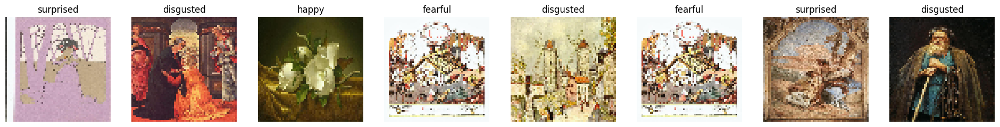

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import random

# Plot some random images from the first batch with their labels

def plot_random_images(images, labels, label_encoder, num_images=5):
    fig, axes = plt.subplots(1, num_images, figsize=(num_images * 3, 3))

    for i in range(num_images):
        random_index = random.randint(0, len(images) - 1)

        # Get a random image and its label from the first batch
        image = images[random_index]
        label = labels[random_index]

        # Reverse the one-hot encoding to get the label index
        label_index = np.argmax(label)

        # Get the actual label string using the LabelEncoder
        actual_label = label_encoder.inverse_transform([label_index])[0]

        # Plot the image and its label
        axes[i].imshow(image)
        axes[i].set_title(actual_label)
        axes[i].axis('off')

    plt.show()

plot_random_images(first_batch_images, first_batch_labels, label_encoder, num_images=8)

# Preprocess image and labels into a dataset for training

In [ ]:
train_generator

In [ ]:
from sklearn.model_selection import train_test_split

# Split file paths and labels into training and validation sets
train_file_paths, val_file_paths, train_labels, val_labels = train_test_split(
    df_filtered_1['file_path'].values, encoded_labels, test_size=0.08, random_state=512
)

In [ ]:
import tensorflow as tf

def load_and_preprocess_image(file_path, label):
    image = tf.io.read_file(file_path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.resize(image, [64, 64])
    image = (image - 127.5) / 127.5  # Rescale the images to the range [-1, 1]
    return image, label

def create_dataset(file_paths, labels, batch_size=32, shuffle=True):
    # Create a dataset from file paths and labels
    dataset = tf.data.Dataset.from_tensor_slices((file_paths, labels))
    
    # Load and preprocess images
    dataset = dataset.map(load_and_preprocess_image, num_parallel_calls=tf.data.AUTOTUNE)
    
    # Set up the dataset for training
    if shuffle:
        dataset = dataset.shuffle(10000)
    dataset = dataset.batch(batch_size, drop_remainder=True) # Drop the last batch if it's incomplete
    dataset = dataset.prefetch(buffer_size=tf.data.AUTOTUNE)
    
    return dataset

In [ ]:
# Create the training dataset
train_dataset = create_dataset(train_file_paths, train_labels, batch_size=16)
# Create the validation dataset (without shuffling)
val_dataset = create_dataset(val_file_paths, val_labels, batch_size=16, shuffle=False)

In [ ]:
train_dataset, val_dataset

(<PrefetchDataset element_spec=(TensorSpec(shape=(16, 64, 64, 3), dtype=tf.float32, name=None), TensorSpec(shape=(16,), dtype=tf.int32, name=None))>,
 <PrefetchDataset element_spec=(TensorSpec(shape=(16, 64, 64, 3), dtype=tf.float32, name=None), TensorSpec(shape=(16,), dtype=tf.int32, name=None))>)

## Plot random image from both dataset to make sure everything looks good. 

In [ ]:
def plot_images_from_first_batch(dataset, label_encoder, num_images=5):
    '''
    Only ploting images out from the first batch to prevent long time iteration through all datas
    '''
    # Take the first batch from the dataset
    first_batch = next(iter(dataset))

    # Get the images and labels from the first batch
    images, labels = first_batch
    # print(labels)
    # Plot the images and their labels
    fig, axes = plt.subplots(1, num_images, figsize=(15, 5))
    for i, (image, label) in enumerate(zip(images[:num_images], labels[:num_images])):
        # Decode the label
        decoded_label = label_encoder.inverse_transform([label.numpy()])
        # print(decoded_label)
        # Rescale the image to the range [0, 1]
        image = (image.numpy() + 1) / 2

        # Plot the image and its label
        axes[i].imshow(image)
        axes[i].set_title(f"Label: {decoded_label[0]}")
        axes[i].axis('off')

    plt.show()


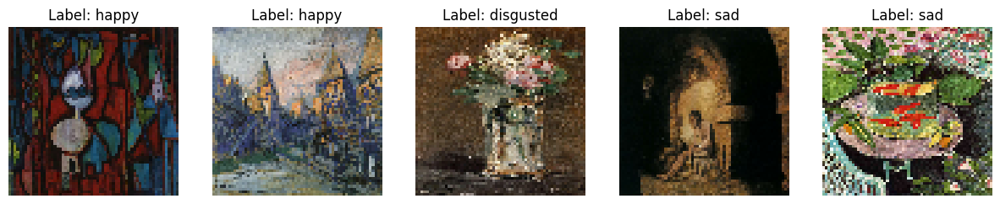

In [ ]:
# Plot some images from the first batch of the train dataset
plot_images_from_first_batch(train_dataset, label_encoder, num_images=5)

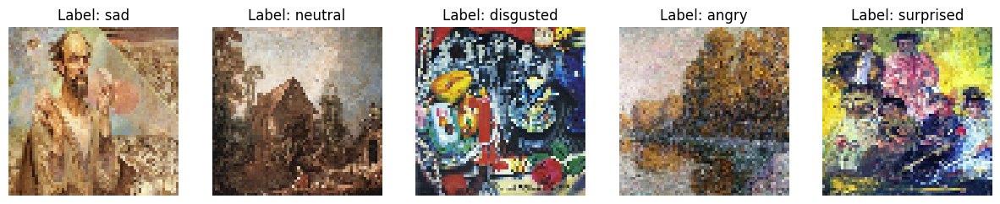

In [ ]:
# Plot some images from the first batch of the val dataset
plot_images_from_first_batch(val_dataset, label_encoder, num_images=5)

# Define GAN

In [ ]:
import tensorflow as tf
from tensorflow.keras import Model
from tensorflow.keras.layers import Dense, Reshape, Conv2D, BatchNormalization, Input, Embedding, Concatenate
from tensorflow.keras.layers import LeakyReLU, Dropout, Flatten, Activation, MaxPooling2D, Conv2DTranspose, GaussianNoise
from tensorflow import keras
import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt
from IPython.display import clear_output
from tensorflow.keras import backend as K

In [ ]:
tf.config.list_physical_devices('GPU')

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [ ]:
class cGAN():
    def __init__(self,
                 latent_dim,
                 num_classes,
                 input_shape,
                 g_dense_shape,
                 g_filters,
                 g_kernels,
                 g_strides,
                 g_output_kernels,
                 g_output_stride,
                 # g_dropout,
                 d_filters,
                 d_kernels,
                 d_pools,
                 d_dropout,
                 d_dense_units,
                 init_stddev,
                 relu_alpha,
                 bn_momentum,
                 epsilon,
                 gn_ratio):
        
        # Define all the input argument that will be used in this model
        self.latent_dim = latent_dim
        self.num_classes = num_classes
        self.input_shape = input_shape
        self.g_dense_shape = g_dense_shape
        self.g_filters = g_filters
        self.g_kernels = g_kernels
        self.g_strides = g_strides
        self.g_output_kernels = g_output_kernels
        self.g_output_stride = g_output_stride
        # self.g_dropout = g_dropout
        self.d_filters = d_filters
        self.d_kernels = d_kernels
        self.d_pools = d_pools
        self.d_dropout = d_dropout
        self.d_dense_units = d_dense_units
        self.init_stddev = init_stddev
        self.relu_alpha = relu_alpha
        self.bn_momentum = bn_momentum
        self.epsilon = epsilon
        self.gn_ratio = gn_ratio
        
        # Automatically build the model when initiated
        self._build()
        
    # Define the building blocks for the GAN
    def _build(self):
        self._build_generator()
        self._build_discriminator()
        # self._build_gan()

    # Define the structure of the generator
    def _build_generator(self):
        # 1) Get input
        noise_input, g_label_input = self._add_generator_input()
        # 2) Embed label with noise input
        g_embedded_input = self._add_g_label_embedding(noise_input, g_label_input)
        # 2) Dense reshape
        reshaped_features = self._add_dense_reshape(g_embedded_input)
        # 3) Use reconstruction blocks to restore features
        reconstructed_features = self._add_transposed_blocks(reshaped_features)
        # 4) Output reconstructed image
        g_output = self._add_output_layer(reconstructed_features)
        self.generator = Model([noise_input, g_label_input], g_output, name="generator")
        
    def _add_generator_input(self):
        input_noise = Input(shape=(self.latent_dim,))
        input_label = Input(shape=(1,))
        return input_noise, input_label
    
    def _add_g_label_embedding(self, noise_input, g_label_input):
        # Embedding labels
        label_embedding = Embedding(self.num_classes, self.latent_dim)(g_label_input)
        label_embedding = Flatten()(label_embedding)
        # Concatenate with noise input
        x = Concatenate()([noise_input, label_embedding])
        return x
    
    def _add_dense_reshape(self, g_embedded_input):
        # Connect and reshape to the target shape for reconstruction blocks
        x = Dense(np.prod(self.g_dense_shape))(g_embedded_input)
        x = Reshape(self.g_dense_shape)(x)
        return x
    
    def _add_transposed_blocks(self, reshaped_features):
        x = reshaped_features
        # Use a loop to add multiple blocks
        for i in range(len(self.g_filters)):
            x = Conv2DTranspose(
                self.g_filters[i], 
                kernel_size=self.g_kernels[i], 
                strides=self.g_strides[i], 
                padding="same", 
                kernel_initializer= keras.initializers.TruncatedNormal(stddev=self.init_stddev)
            )(x)
            x = LeakyReLU(alpha=self.relu_alpha)(x)
            x = BatchNormalization(momentum=self.bn_momentum, epsilon=self.epsilon)(x)
            # x = Dropout(self.g_dropout)(x)
        return x
    
    def _add_output_layer(self, reconstructed_features):
        # Restore the correct shape of output image
        x= Conv2DTranspose(
            self.input_shape[-1], 
            kernel_size=self.g_output_kernels, 
            strides=self.g_output_stride, 
            padding="same", 
            kernel_initializer= keras.initializers.TruncatedNormal(stddev=self.init_stddev)
        )(reconstructed_features)
        output_image = Activation('tanh')(x)
        return output_image
    
    # Define the structure of the discriminator
    def _build_discriminator(self):
        # 1) Get input
        image_input, d_label_input = self._add_discriminator_input()
        # 2) Use only the image input to extract features
        conv_features = self._add_conv_layers(image_input)
        # 3) Flatten features and embed with labels
        d_embedded_features = self._add_d_label_embedding(conv_features, d_label_input)
        # 4) Use multiple dense layers to calculate validity
        validity = self._add_dense_validity(d_embedded_features)
        self.discriminator = Model([image_input, d_label_input], validity, name="discriminator")
    
    def _add_discriminator_input(self):
        input_image = Input(shape=self.input_shape)
        input_label = Input(shape=(1,))
        return input_image, input_label
        
    def _add_conv_layers(self, image_input):
        x = image_input
        # Iterate through each convolution block
        for i in range(len(self.d_dropout)):
            # add multiple conv layers in each block
            for o in range(len(self.d_filters)):
                x = Conv2D(
                    self.d_filters[o],
                    kernel_size=self.d_kernels[o],
                    padding="same"
                )(x)
                x = LeakyReLU(alpha=self.relu_alpha)(x)
                x = BatchNormalization()(x)
                x = GaussianNoise(self.gn_ratio)(x)
            x = MaxPooling2D(pool_size=self.d_pools[i])(x)
            x = Dropout(self.d_dropout[i])(x)
        return x
    
    def _add_d_label_embedding(self, conv_features, d_label_input):
        # Flatten image features
        features = GaussianNoise(self.gn_ratio)(conv_features)
        features = Flatten()(features)
        # Embed with labels
        label_embedding = Embedding(self.num_classes, np.prod(conv_features.shape[1:]))(d_label_input)
        label_embedding = Flatten()(label_embedding)
        x = Concatenate()([features, label_embedding])
        x = Dropout(0.4)(x)
        return x
    
    def _add_dense_validity(self, d_embedded_features):
        x = d_embedded_features
        # Use a loop to add multiple dense layers
        for i in range(len(self.d_dense_units)):
            x = Dense(self.d_dense_units[i])(x)
            x = LeakyReLU(alpha=self.relu_alpha)(x)
        # Use a final dense layer with unit = 1 to calculate validity
        x = Dense(1)(x)
        return x

    def summary(self):
        self.generator.summary()
        self.discriminator.summary()
        # self.gan.summary()

    def compile(self, g_optimizer, g_loss, d_optimizer, d_loss):
        self.g_optimizer = g_optimizer
        self.g_loss = g_loss
        self.d_optimizer = d_optimizer
        self.d_loss = d_loss
        
    def generator_loss(self, fake_output, real_labels, class_weights):
        real_labels = tf.ones_like(real_labels)
        unweighted_loss = self.g_loss(real_labels, fake_output)
        # Apply class weights to the loss
        real_labels_one_hot = tf.one_hot(real_labels, depth=len(class_weights))
        weighted_loss = unweighted_loss * tf.reduce_sum(real_labels_one_hot * class_weights, axis=-1)
        return tf.reduce_mean(weighted_loss)

    def discriminator_loss(self, real_output, fake_output, real_labels, class_weights):
        cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)
        real_loss = cross_entropy(tf.ones_like(real_output), real_output)
        fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
        unweighted_total_loss = real_loss + fake_loss
        # Apply class weights to the loss
        real_labels_one_hot = tf.one_hot(real_labels, depth=len(class_weights))
        weighted_loss = unweighted_total_loss * tf.reduce_sum(real_labels_one_hot * class_weights, axis=-1)
        return tf.reduce_mean(weighted_loss)
    
    def gradient_penalty_loss(self, real_images, fake_images, real_labels, batch_size, class_weights):
        alpha = tf.random.normal([batch_size, 1, 1, 1], 0.0, 1.0)
        interpolated_images = alpha * real_images + (1 - alpha) * fake_images
        with tf.GradientTape() as tape:
            tape.watch(interpolated_images)
            validity_interpolated = self.discriminator([interpolated_images, real_labels])

        gradients = tape.gradient(validity_interpolated, interpolated_images)
        gradients_sqr = K.square(gradients)
        gradients_sqr_sum = K.sum(gradients_sqr, axis=np.arange(1, len(gradients_sqr.shape)))
        gradient_l2_norm = K.sqrt(gradients_sqr_sum)
        unweighted_gradient_penalty = K.square(1 - gradient_l2_norm)
        # Apply class weights to the loss
        real_labels_one_hot = tf.one_hot(real_labels, depth=len(class_weights))
        weighted_loss = unweighted_gradient_penalty * tf.reduce_sum(real_labels_one_hot * class_weights, axis=-1)
        return K.mean(weighted_loss)

In [ ]:
# save images each epochs through the training process
def save_images(epoch, generator, noise_dim, num_classes, n_images=16):
    # Generate noise and labels
    random_noise = np.random.normal(0, 1, (n_images, noise_dim))
    fake_labels = np.random.randint(0, num_classes, (n_images, 1))

    # Generate fake images
    fake_images = generator.predict([random_noise, fake_labels])

    # Rescale images to [0, 1] range
    fake_images = 0.5 * fake_images + 0.5

    # Plot the images
    fig, axs = plt.subplots(4, 4, figsize=(10, 10))
    for i, ax in enumerate(axs.flat):
        ax.imshow(fake_images[i])
        ax.set_title(f'Label: {fake_labels[i][0]}')
        ax.axis('off')

    # Save the images to filepath
    os.makedirs('images', exist_ok=True)
    fig.savefig(f'images/70eps_smaller_epoch_{epoch + 1}.png')
    plt.close()

In [ ]:
from tqdm.auto import tqdm

def train_gan(gan, train_dataset, val_dataset, epochs, batch_size, noise_dim, num_classes, class_weights, save_path='./best_gan/', gp_weight=10.0):
    generator_loss_history = []
    val_gen_loss_history = []
    best_g_loss = float("inf")
    
    for epoch in range(epochs):
        print(f"Epoch {epoch+1}/{epochs}")
        progress_bar = tqdm(enumerate(train_dataset), total=len(train_dataset))
        
        for step, (real_images, real_labels) in progress_bar:
            actual_batch_size = real_labels.shape[0]
            random_noise = np.random.normal(0, 1, (actual_batch_size, noise_dim))
            fake_labels = np.random.randint(0, num_classes, (actual_batch_size, 1))

            with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
                fake_images = gan.generator([random_noise, fake_labels])
                real_output = gan.discriminator([real_images, real_labels], training=True)
                fake_output = gan.discriminator([fake_images, fake_labels], training=True)

                gen_loss = gan.generator_loss(fake_output, real_labels, class_weights)
                disc_loss = gan.discriminator_loss(real_output, fake_output, real_labels, class_weights)
                gp_loss = gan.gradient_penalty_loss(real_images, fake_images, real_labels, actual_batch_size, class_weights)
                disc_loss = disc_loss + gp_weight * gp_loss

            generator_gradients = gen_tape.gradient(gen_loss, gan.generator.trainable_variables)
            discriminator_gradients = disc_tape.gradient(disc_loss, gan.discriminator.trainable_variables)

            gan.g_optimizer.apply_gradients(zip(generator_gradients, gan.generator.trainable_variables))
            gan.d_optimizer.apply_gradients(zip(discriminator_gradients, gan.discriminator.trainable_variables))

            progress_bar.set_description(f"Step {step}: d_loss = {disc_loss:.6f}, g_loss = {gen_loss:.6f}")

        # Save generated images at the end of each epoch
        save_images(epoch, gan.generator, noise_dim, num_classes)
        
        # Validation
        val_gen_losses = []
        val_disc_losses = []

        for real_images, real_labels in val_dataset:
            random_noise = np.random.normal(0, 1, (batch_size, noise_dim))
            fake_labels = np.random.randint(0, num_classes, (batch_size, 1))
            fake_labels = tf.reshape(fake_labels, real_labels.shape)

            fake_images = gan.generator([random_noise, fake_labels])
            real_output = gan.discriminator([real_images, real_labels], training=False)
            fake_output = gan.discriminator([fake_images, fake_labels], training=False)

            gen_loss = gan.generator_loss(fake_output, real_labels, class_weights)
            disc_loss = gan.discriminator_loss(real_output, fake_output, real_labels, class_weights)

            val_gen_losses.append(gen_loss.numpy())
            val_disc_losses.append(disc_loss.numpy())

        val_gen_loss = np.mean(val_gen_losses)
        val_disc_loss = np.mean(val_disc_losses)
        print(f"Validation: d_loss = {val_disc_loss:.6f}, g_loss = {val_gen_loss:.6f}")
        
        # Append the generator loss for the current epoch to the list
        generator_loss_history.append(gen_loss)
        val_gen_loss_history.append(val_gen_loss)
        
        # Check if the generator loss has improved
        if val_gen_loss < best_g_loss:
            # Save the generator and discriminator models if the loss has improved
            best_g_loss = val_gen_loss
            gen_save_directory = os.path.join(save_path, '70eps_smaller_best_generator')
            os.makedirs(gen_save_directory, exist_ok=True)
            gan.generator.save(gen_save_directory)
            print(f'Saved best generator at{epoch} to "{gen_save_directory}"!')
            dis_save_directory = os.path.join(save_path, '70eps_smaller_best_discriminator')
            os.makedirs(dis_save_directory, exist_ok=True)
            gan.discriminator.save(dis_save_directory)
            print(f'Saved best discriminator at{epoch} to "{dis_save_directory}"!')
    
    return generator_loss_history, val_gen_loss_history

In [ ]:
gan = cGAN(
        latent_dim = 128,
        num_classes = 7,
        input_shape = (64, 64, 3),
        g_dense_shape = (4, 4, 256),
        g_filters = [256, 256, 128],
        g_kernels = [3, 3, 3],
        g_strides = [2, 2, 2],
        g_output_kernels = 3,
        g_output_stride = 2,
        # g_dropout = 0.25,
        d_filters = [256, 128],
        d_kernels = [3, 3],
        d_pools = [(3,3), (3,3), (3,3)],
        d_dropout = [0.2, 0.2, 0.3],
        d_dense_units = [128],
        init_stddev = 0.02,
        relu_alpha = 0.2,
        bn_momentum = 0.9,
        epsilon = 0.00001,
        gn_ratio = 0.1
    )
gan.summary()

Model: "generator"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 1)]          0           []                               
                                                                                                  
 embedding (Embedding)          (None, 1, 128)       896         ['input_2[0][0]']                
                                                                                                  
 input_1 (InputLayer)           [(None, 128)]        0           []                               
                                                                                                  
 flatten (Flatten)              (None, 128)          0           ['embedding[0][0]']              
                                                                                          

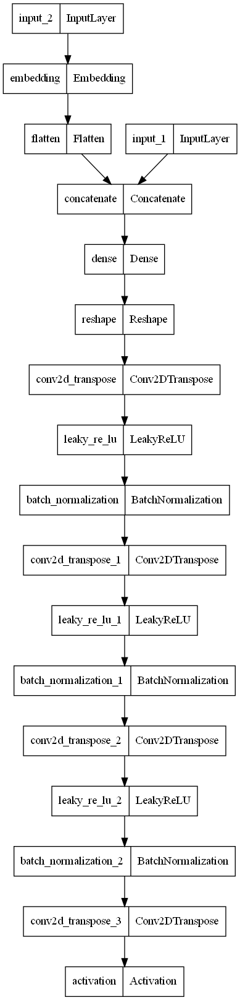

In [ ]:
# Plot out Generator for better visualization
from tensorflow.keras.utils import plot_model

plot_model(gan.generator)

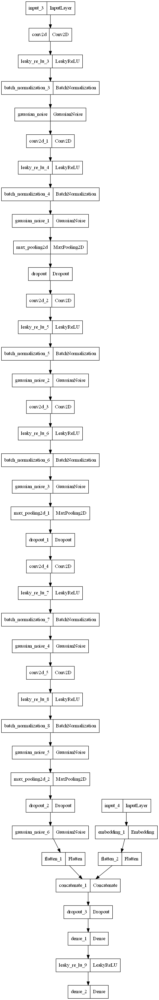

In [ ]:
# Plot out Generator for better visualization
plot_model(gan.discriminator)

In [ ]:
#Defining the number of epochs
EPOCHS = 70
BATCH_SIZE=16
NOISE_DIM=128
NUM_CLASS=7

gan.compile(
    g_optimizer=keras.optimizers.Adam(learning_rate=2e-4),
    g_loss=keras.losses.BinaryCrossentropy(from_logits=True),
    d_optimizer=keras.optimizers.Adam(learning_rate=2e-4),
    d_loss=keras.losses.BinaryCrossentropy(from_logits=True)
)

# train_subset = train_dataset.take(6000)
# val_subset = val_dataset.take(1000)

generator_loss_history, val_gen_loss_history=train_gan(gan=gan,
                                                train_dataset=train_dataset, 
                                                val_dataset=val_dataset, 
                                                epochs=EPOCHS, 
                                                batch_size=BATCH_SIZE,
                                                noise_dim=NOISE_DIM,
                                                num_classes=NUM_CLASS,
                                                class_weights=class_weights_tensor,
                                                save_path='./best_gan/')

Epoch 1/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 128ms/step
Validation: d_loss = 1.297154, g_loss = 2.654251


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_generator\assets


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_generator\assets


Saved best generator at0 to "./best_gan/70eps_smaller_best_generator"!


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_discriminator\assets


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_discriminator\assets


Saved best discriminator at0 to "./best_gan/70eps_smaller_best_discriminator"!
Epoch 2/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 16ms/step
Validation: d_loss = 1.106183, g_loss = 2.144345


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_generator\assets


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_generator\assets


Saved best generator at1 to "./best_gan/70eps_smaller_best_generator"!


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_discriminator\assets


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_discriminator\assets


Saved best discriminator at1 to "./best_gan/70eps_smaller_best_discriminator"!
Epoch 3/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 16ms/step
Validation: d_loss = 1.377564, g_loss = 0.728909


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_generator\assets


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_generator\assets


Saved best generator at2 to "./best_gan/70eps_smaller_best_generator"!


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_discriminator\assets


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_discriminator\assets


Saved best discriminator at2 to "./best_gan/70eps_smaller_best_discriminator"!
Epoch 4/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 15ms/step
Validation: d_loss = 0.987860, g_loss = 0.998590
Epoch 5/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 15ms/step
Validation: d_loss = 1.324717, g_loss = 0.598126


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_generator\assets


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_generator\assets


Saved best generator at4 to "./best_gan/70eps_smaller_best_generator"!


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_discriminator\assets


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_discriminator\assets


Saved best discriminator at4 to "./best_gan/70eps_smaller_best_discriminator"!
Epoch 6/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 20ms/step
Validation: d_loss = 0.987845, g_loss = 1.081699
Epoch 7/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 15ms/step
Validation: d_loss = 1.151328, g_loss = 0.776601
Epoch 8/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 25ms/step
Validation: d_loss = 1.144683, g_loss = 1.900835
Epoch 9/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 15ms/step
Validation: d_loss = 1.265388, g_loss = 0.545145


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_generator\assets


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_generator\assets


Saved best generator at8 to "./best_gan/70eps_smaller_best_generator"!


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_discriminator\assets


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_discriminator\assets


Saved best discriminator at8 to "./best_gan/70eps_smaller_best_discriminator"!
Epoch 10/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 16ms/step
Validation: d_loss = 1.448053, g_loss = 0.403210


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_generator\assets


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_generator\assets


Saved best generator at9 to "./best_gan/70eps_smaller_best_generator"!


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_discriminator\assets


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_discriminator\assets


Saved best discriminator at9 to "./best_gan/70eps_smaller_best_discriminator"!
Epoch 11/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 16ms/step
Validation: d_loss = 1.028760, g_loss = 1.118033
Epoch 12/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 23ms/step
Validation: d_loss = 1.145529, g_loss = 0.820989
Epoch 13/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 16ms/step
Validation: d_loss = 1.144952, g_loss = 0.700761
Epoch 14/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 2ms/step
Validation: d_loss = 1.162152, g_loss = 0.755925
Epoch 15/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 19ms/step
Validation: d_loss = 1.172726, g_loss = 1.081930
Epoch 16/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 22ms/step
Validation: d_loss = 1.801531, g_loss = 0.251877


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_generator\assets


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_generator\assets


Saved best generator at15 to "./best_gan/70eps_smaller_best_generator"!


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_discriminator\assets


INFO:tensorflow:Assets written to: ./best_gan/70eps_smaller_best_discriminator\assets


Saved best discriminator at15 to "./best_gan/70eps_smaller_best_discriminator"!
Epoch 17/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 23ms/step
Validation: d_loss = 1.385662, g_loss = 0.488512
Epoch 18/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 14ms/step
Validation: d_loss = 1.476122, g_loss = 0.402578
Epoch 19/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 18ms/step
Validation: d_loss = 1.170894, g_loss = 0.689829
Epoch 20/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 24ms/step
Validation: d_loss = 1.288044, g_loss = 1.862189
Epoch 21/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 16ms/step
Validation: d_loss = 1.207749, g_loss = 0.701664
Epoch 22/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 22ms/step
Validation: d_loss = 1.360374, g_loss = 0.518334
Epoch 23/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 17ms/step
Validation: d_loss = 1.109836, g_loss = 1.065977
Epoch 24/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 25ms/step
Validation: d_loss = 1.400173, g_loss = 0.465815
Epoch 25/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 13ms/step
Validation: d_loss = 1.164499, g_loss = 0.746643
Epoch 26/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 15ms/step
Validation: d_loss = 1.296989, g_loss = 0.560416
Epoch 27/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 18ms/step
Validation: d_loss = 1.327792, g_loss = 0.568360
Epoch 28/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 15ms/step
Validation: d_loss = 1.574495, g_loss = 0.333862
Epoch 29/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 16ms/step
Validation: d_loss = 1.222021, g_loss = 0.810979
Epoch 30/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 19ms/step
Validation: d_loss = 1.340171, g_loss = 0.570284
Epoch 31/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 16ms/step
Validation: d_loss = 1.201006, g_loss = 0.866298
Epoch 32/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 21ms/step
Validation: d_loss = 1.277463, g_loss = 0.636635
Epoch 33/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 16ms/step
Validation: d_loss = 1.275675, g_loss = 0.606771
Epoch 34/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 16ms/step
Validation: d_loss = 1.298537, g_loss = 0.653967
Epoch 35/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 24ms/step
Validation: d_loss = 1.170329, g_loss = 0.916632
Epoch 36/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 20ms/step
Validation: d_loss = 1.255897, g_loss = 0.630699
Epoch 37/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 16ms/step
Validation: d_loss = 1.424500, g_loss = 0.480350
Epoch 38/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 16ms/step
Validation: d_loss = 1.299128, g_loss = 0.560363
Epoch 39/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 22ms/step
Validation: d_loss = 1.246504, g_loss = 0.794144
Epoch 40/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 21ms/step
Validation: d_loss = 1.217067, g_loss = 0.800189
Epoch 41/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 21ms/step
Validation: d_loss = 1.181899, g_loss = 0.795929
Epoch 42/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 15ms/step
Validation: d_loss = 1.358257, g_loss = 0.672242
Epoch 43/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 27ms/step
Validation: d_loss = 1.401289, g_loss = 0.473490
Epoch 44/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 26ms/step
Validation: d_loss = 1.283049, g_loss = 0.664491
Epoch 45/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 17ms/step
Validation: d_loss = 1.347140, g_loss = 0.609017
Epoch 46/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 19ms/step
Validation: d_loss = 1.320438, g_loss = 0.621359
Epoch 47/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 19ms/step
Validation: d_loss = 1.385396, g_loss = 0.518703
Epoch 48/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 23ms/step
Validation: d_loss = 1.250970, g_loss = 0.971795
Epoch 49/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 17ms/step
Validation: d_loss = 1.314683, g_loss = 0.582761
Epoch 50/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 29ms/step
Validation: d_loss = 1.341304, g_loss = 0.593819
Epoch 51/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 22ms/step
Validation: d_loss = 1.402780, g_loss = 0.501433
Epoch 52/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 16ms/step
Validation: d_loss = 1.304247, g_loss = 0.990705
Epoch 53/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 17ms/step
Validation: d_loss = 1.595408, g_loss = 0.368427
Epoch 54/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 14ms/step
Validation: d_loss = 1.509813, g_loss = 0.390602
Epoch 55/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 17ms/step
Validation: d_loss = 1.248197, g_loss = 0.957387
Epoch 56/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 16ms/step
Validation: d_loss = 1.308991, g_loss = 0.814778
Epoch 57/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 21ms/step
Validation: d_loss = 1.375888, g_loss = 0.568318
Epoch 58/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 16ms/step
Validation: d_loss = 1.343942, g_loss = 0.615869
Epoch 59/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 25ms/step
Validation: d_loss = 1.282355, g_loss = 0.787181
Epoch 60/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 23ms/step
Validation: d_loss = 1.366055, g_loss = 0.590587
Epoch 61/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 21ms/step
Validation: d_loss = 1.286587, g_loss = 0.735848
Epoch 62/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 16ms/step
Validation: d_loss = 1.316496, g_loss = 0.643757
Epoch 63/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 24ms/step
Validation: d_loss = 1.359582, g_loss = 0.554526
Epoch 64/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 22ms/step
Validation: d_loss = 1.288983, g_loss = 0.824178
Epoch 65/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 27ms/step
Validation: d_loss = 1.340899, g_loss = 1.080648
Epoch 66/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 26ms/step
Validation: d_loss = 1.491492, g_loss = 0.445282
Epoch 67/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 16ms/step
Validation: d_loss = 1.330365, g_loss = 0.597940
Epoch 68/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 21ms/step
Validation: d_loss = 1.653234, g_loss = 0.314440
Epoch 69/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 24ms/step
Validation: d_loss = 1.341085, g_loss = 0.669714
Epoch 70/70


  0%|          | 0/4558 [00:00<?, ?it/s]

1/1 [==============================] - 0s 17ms/step
Validation: d_loss = 1.294096, g_loss = 0.870424


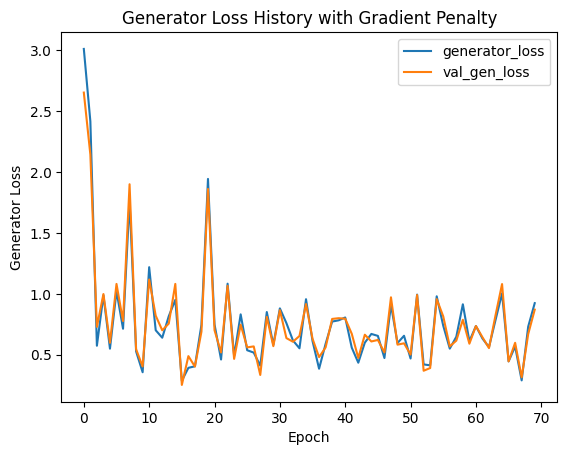

In [ ]:
plt.plot(generator_loss_history, label='generator_loss')
plt.plot(val_gen_loss_history, label='val_gen_loss')
plt.xlabel('Epoch')
plt.ylabel('Generator Loss')
plt.title('Generator Loss History with Gradient Penalty')
plt.legend()
plt.show()

## Using val dataset label to generate some image

1/1 [==============================] - 0s 81ms/step


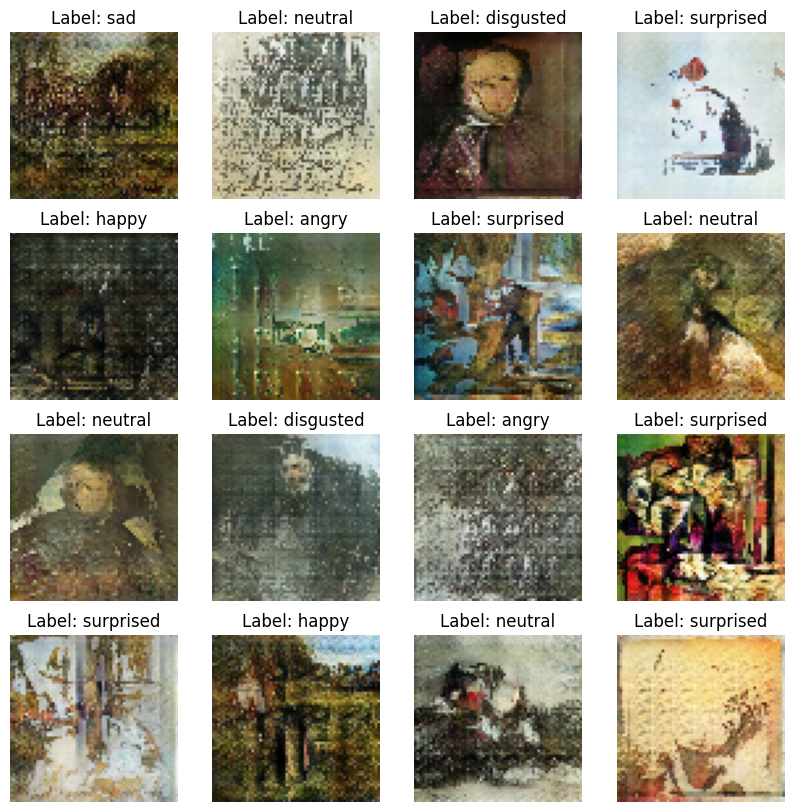

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def generate_and_plot_images_with_actual_labels(generator, num_examples, noise_dim, dataset, label_encoder):
    # Generate random noise
    noise = np.random.normal(0, 1, (num_examples, noise_dim))

    # Extract a subset of actual labels
    actual_labels = []
    for _, labels in dataset:
        actual_labels.extend(labels.numpy())
        if len(actual_labels) >= num_examples:
            break
    selected_labels = np.array(actual_labels[:num_examples])

    # Decode the selected labels
    decoded_labels = label_encoder.inverse_transform(selected_labels)

    # Generate images using the generator
    generated_images = generator.predict([noise, selected_labels])

    # Rescale images to [0, 1] range
    generated_images = 0.5 * generated_images + 0.5

    # Plot the generated images
    plt.figure(figsize=(10, 10))
    rows = int(np.sqrt(num_examples))
    cols = int(np.sqrt(num_examples))
    for i in range(num_examples):
        plt.subplot(rows, cols, i+1)
        plt.imshow(generated_images[i], cmap='gray')
        plt.axis('off')
        plt.title(f"Label: {decoded_labels[i]}")
    plt.show()

# Generate and plot images
generate_and_plot_images_with_actual_labels(gan.generator, 16, NOISE_DIM, val_dataset, label_encoder)

## Generated image with custom input labels

1/1 [==============================] - 0s 20ms/step


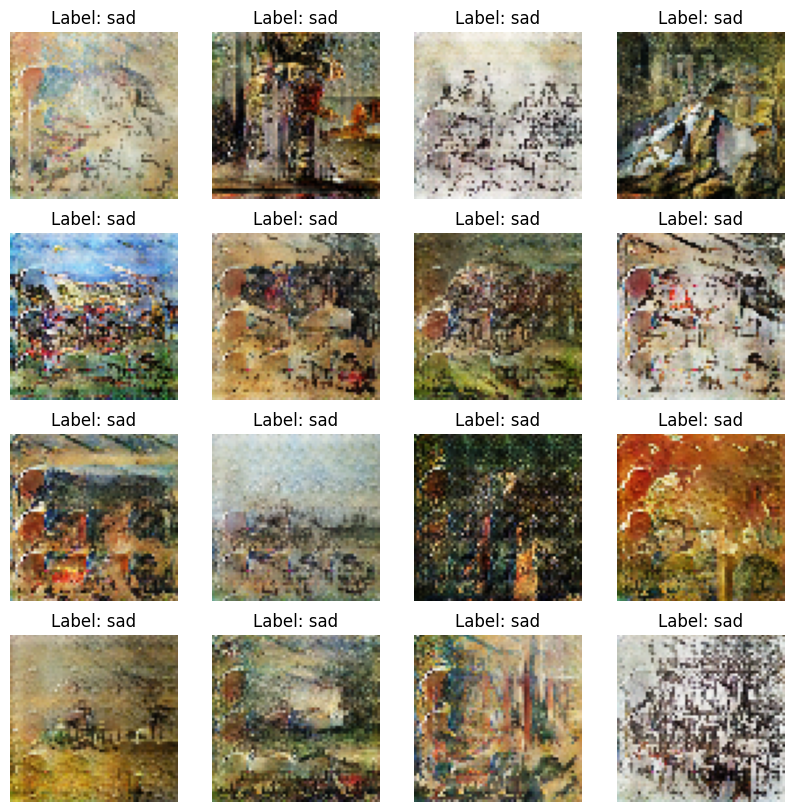

In [ ]:
def generate_and_plot_images_with_specific_label(generator, num_examples, noise_dim, label, label_encoder):
    # Generate random noise
    noise = np.random.normal(0, 1, (num_examples, noise_dim))

    # Encode the specific label
    encoded_label = label_encoder.transform([label] * num_examples)

    # Generate images using the generator
    generated_images = generator.predict([noise, encoded_label])

    # Rescale images to [0, 1] range
    generated_images = 0.5 * generated_images + 0.5

    # Plot the generated images
    plt.figure(figsize=(10, 10))
    rows = int(np.sqrt(num_examples))
    cols = int(np.sqrt(num_examples))
    for i in range(num_examples):
        plt.subplot(rows, cols, i+1)
        plt.imshow(generated_images[i], cmap='gray')
        plt.axis('off')
        plt.title(f"Label: {label}")
    plt.show()
    
specific_label = 'sad' # Custom input labels
generate_and_plot_images_with_specific_label(gan.generator, 16, NOISE_DIM, specific_label, label_encoder)

# Save the model, load it back for genertaion

In [ ]:
save_path='./best_gan/'
gen_save_directory = os.path.join(save_path, 'smaller_generator_70eps')
os.makedirs(gen_save_directory, exist_ok=True)
gan.generator.save(gen_save_directory)
dis_save_directory = os.path.join(save_path, 'smaller_discriminator_70eps')
os.makedirs(dis_save_directory, exist_ok=True)
gan.discriminator.save(dis_save_directory)

INFO:tensorflow:Assets written to: ./best_gan/smaller_generator_70eps\assets


INFO:tensorflow:Assets written to: ./best_gan/smaller_generator_70eps\assets


INFO:tensorflow:Assets written to: ./best_gan/smaller_discriminator_70eps\assets


INFO:tensorflow:Assets written to: ./best_gan/smaller_discriminator_70eps\assets


## Load back saved model for generation to make sure it works

We are saving the model that trained for 70 epochs here. Later we will compare with `best_model` that we saved during training base on lowest validation generator loss, and see which works better.

In [ ]:
NOISE_DIM=128
import cv2

# Upscale the generated images
def upscale_bicubic(image, scale_factor):
    image = image.numpy()
    height, width, _ = image.shape
    new_height, new_width = int(height * scale_factor), int(width * scale_factor)
    return cv2.resize(image, (new_width, new_height), interpolation=cv2.INTER_CUBIC)

def load_and_generate_images_with_specific_label(model_folder, num_examples, noise_dim, label, label_encoder):
    # Load the saved generator model
    folder_path = './best_gan/'
    generator_path = os.path.join(folder_path, model_folder)
    generator = tf.keras.models.load_model(generator_path)

    # Generate random noise
    noise = tf.random.normal([num_examples, noise_dim])
    label_idx = label_encoder.transform([label])[0]
    labels = np.full(num_examples, label_idx)

    generated_images = generator([noise, labels], training=False)

    # Rescale images to [0, 1] range
    generated_images = 0.5 * generated_images + 0.5

    # Upscale each image
    upscaled_images = [upscale_bicubic(image, scale_factor=5.0) for image in generated_images]

    # Plot the generated images
    plt.figure(figsize=(10, 10))
    for i, image in enumerate(upscaled_images):
        plt.subplot(4, 4, i+1)
        plt.imshow(np.clip(image, 0, 1))  # Clip pixel values to [0, 1] range
        plt.title(label)
        plt.axis('off')
    plt.show()

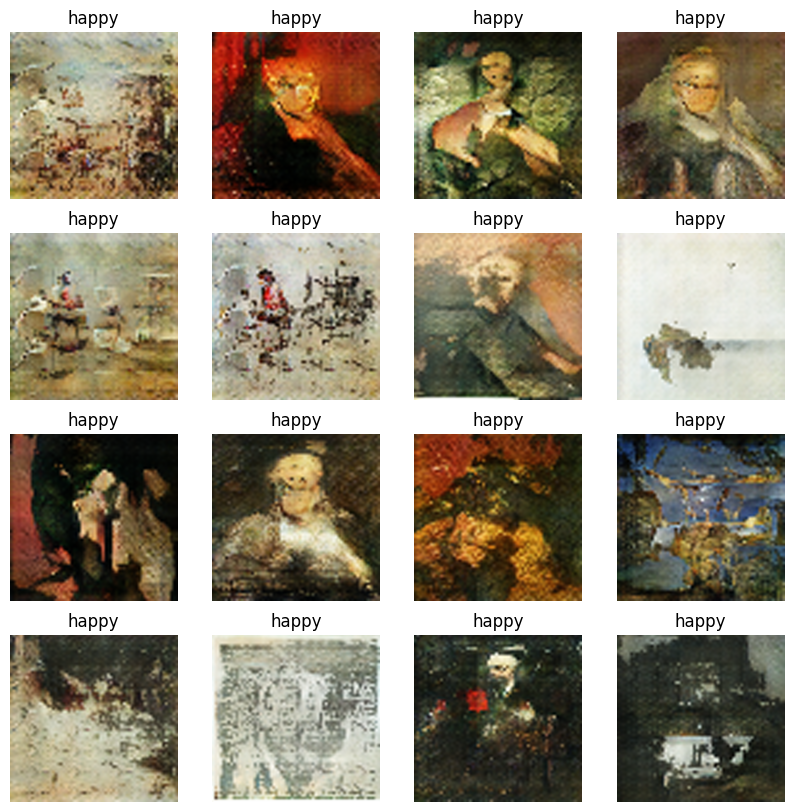

In [ ]:
model_folder = 'smaller_generator_70eps'   # model trained for 70 epochs
specific_label = 'happy'       # custom label
load_and_generate_images_with_specific_label(model_folder, 16, NOISE_DIM, specific_label, label_encoder)

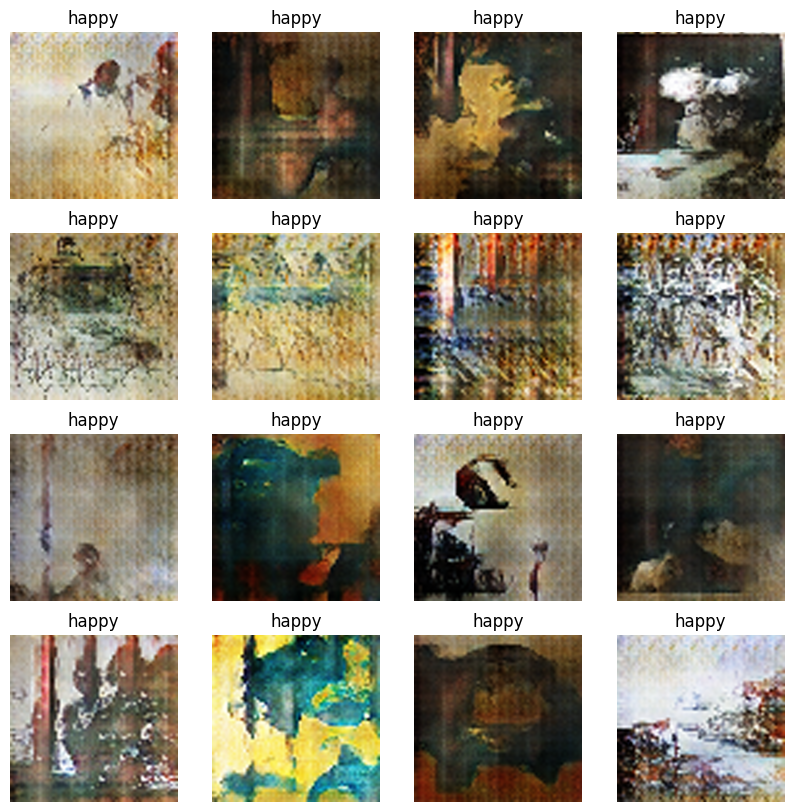

In [ ]:
model_folder = '70eps_smaller_best_generator'   # model saved on lowest val_gen_loss
specific_label = 'happy'       # custom label
load_and_generate_images_with_specific_label(model_folder, 16, NOISE_DIM, specific_label, label_encoder)

Seems like model that trained for 70 epochs performs better, generates stable images

# Import artemis pretrained model to make prediction on generated images

In [ ]:
import torch
from torchvision.transforms import ToTensor, Normalize, Compose
torch.cuda.is_available()

False

In [ ]:
model_path = './best_model.pt'
artemis_model = torch.load(model_path, map_location=torch.device('cpu')) # Since it's not detecting my cuda, we will use cpu here
artemis_model.eval()  # Set the model to evaluation mode

C:\Users\lzhan\miniconda3\envs\tf\lib\site-packages\torch\serialization.py:888: SourceChangeWarning: source code of class 'torch.nn.modules.container.Sequential' has changed. you can retrieve the original source code by accessing the object's source attribute or set `torch.nn.Module.dump_patches = True` and use the patch tool to revert the changes.
  warnings.warn(msg, SourceChangeWarning)
C:\Users\lzhan\miniconda3\envs\tf\lib\site-packages\torch\serialization.py:888: SourceChangeWarning: source code of class 'torch.nn.modules.conv.Conv2d' has changed. you can retrieve the original source code by accessing the object's source attribute or set `torch.nn.Module.dump_patches = True` and use the patch tool to revert the changes.
  warnings.warn(msg, SourceChangeWarning)
C:\Users\lzhan\miniconda3\envs\tf\lib\site-packages\torch\serialization.py:888: SourceChangeWarning: source code of class 'torch.nn.modules.batchnorm.BatchNorm2d' has changed. you can retrieve the original source code by ac

ImageEmotionClassifier(
  (img_encoder): ResnetEncoder(
    (resnet): Sequential(
      (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (4): Sequential(
        (0): BasicBlock(
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu): ReLU(inplace=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        )
        (1): BasicBlock(
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn1): B

In [ ]:
# Upscale generated image
def upscale_bicubic(image, scale_factor):
    image = image.numpy()
    height, width, _ = image.shape
    new_height, new_width = int(height * scale_factor), int(width * scale_factor)
    return cv2.resize(image, (new_width, new_height), interpolation=cv2.INTER_CUBIC)

def load_and_generate_images_with_specific_label(model_folder, num_examples, noise_dim, label, label_encoder):
    # Load the saved generator model
    folder_path = './best_gan/'
    generator_path = os.path.join(folder_path, model_folder)
    generator = tf.keras.models.load_model(generator_path)

    # Generate random noise
    noise = tf.random.normal([num_examples, noise_dim])
    label_idx = label_encoder.transform([label])[0]
    labels = np.full(num_examples, label_idx)

    generated_images = generator([noise, labels], training=False)

    # Rescale images to [0, 1] range
    generated_images = 0.5 * generated_images + 0.5

    return generated_images

In [ ]:
NOISE_DIM = 128

model_folder = 'smaller_generator_70eps'   # Saved model folder
specific_label = 'fearful'       # custom label
generated_images = load_and_generate_images_with_specific_label(model_folder, 16, NOISE_DIM, specific_label, label_encoder)

In [ ]:
# Turn generated images to np.array
generated_images_array = np.array(generated_images)

In [ ]:
from torchvision import transforms
# Change image tensor to adapt Pytorch (batch, cChannel, W, H)
generated_images_tensor = torch.tensor(generated_images_array, dtype=torch.float32)
generated_images_tensor = generated_images_tensor.permute(0, 3, 1, 2)

## Create dictionary based on our FER-2013 labels

Because the `artemis` pretrained model was trained on their labels, which is different from FER-2013's labels. We need to create a dictionary to manully update the prediction in our case.

In [ ]:
labels_mapping = {
    0: "happy",
    1: "angry",
    2: "surprised",
    3: "neutral",
    4: "disgusted",
    5: "happy",
    6: "fearful",
    7: "sad",
    8: "neutral"
}

## Create a function that visualize the predicted label with generated images. 

In [ ]:
def plot_generated_images_with_predictions(model_folder, artemis_model, num_examples, noise_dim, label, label_encoder, labels_mapping):
    # Load and generate images with a specific label
    generated_images = load_and_generate_images_with_specific_label(model_folder, num_examples, noise_dim, label, label_encoder)

    # Prepare images for prediction
    generated_images = generated_images.numpy()
    generated_images_tensor = torch.from_numpy(generated_images).permute(0, 3, 1, 2)

    # Predict labels using the artemis_model
    predicted_classes = artemis_model(generated_images_tensor)
    predicted_classes = torch.argmax(predicted_classes, dim=1)

    # Decode predicted labels
    decoded_predictions = [labels_mapping[predicted_class.item()] for predicted_class in predicted_classes]

    # Plot the generated images with input and predicted labels
    plt.figure(figsize=(10, 10))
    for i, (image, predicted_label) in enumerate(zip(generated_images, decoded_predictions)):
        plt.subplot(4, 4, i + 1)
        plt.imshow(generated_images[i], aspect='auto')
        plt.title(f"Input: {label}\nPredicted: {predicted_label}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

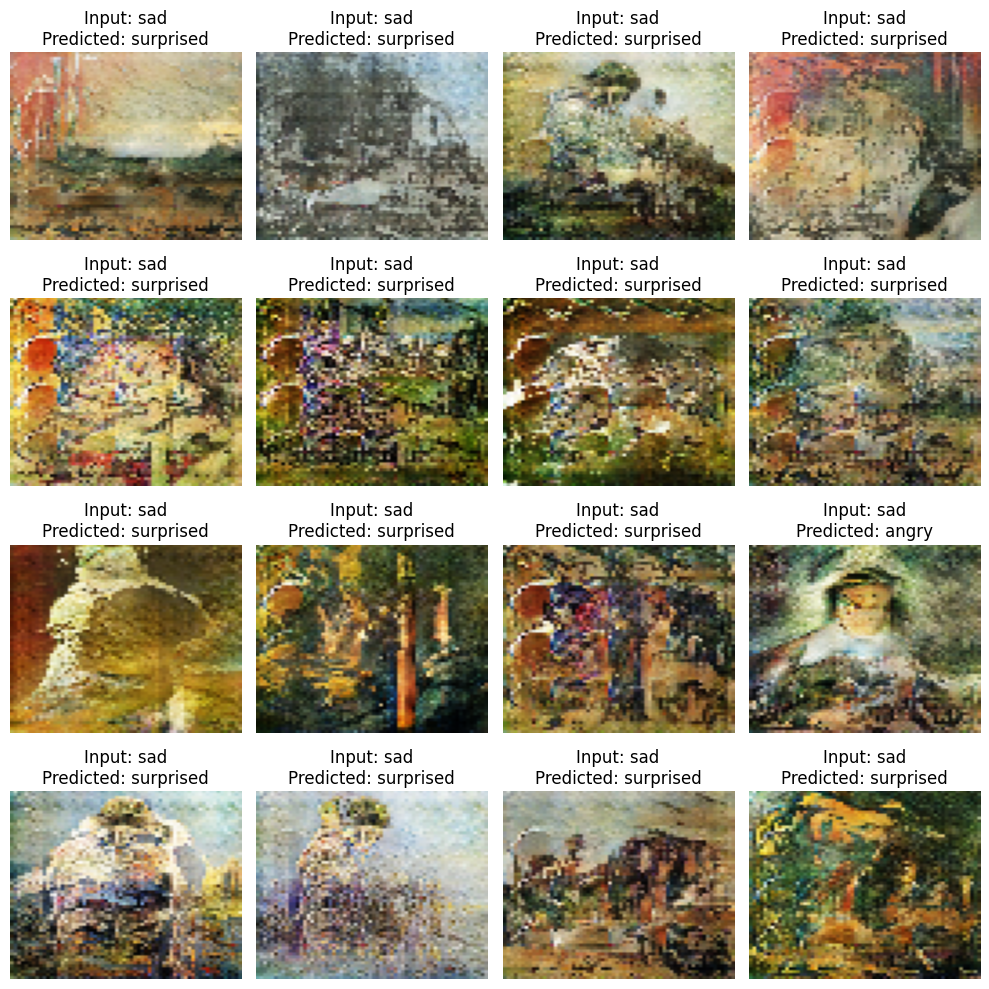

In [ ]:
model_folder = 'smaller_generator_70eps'   # Saved model folder
specific_label = 'sad'       # custom label
plot_generated_images_with_predictions(model_folder,artemis_model, 16, NOISE_DIM, specific_label, label_encoder, labels_mapping)

It seems like the predictions are all different than the label we inputs!! Let's plot out historgram and check

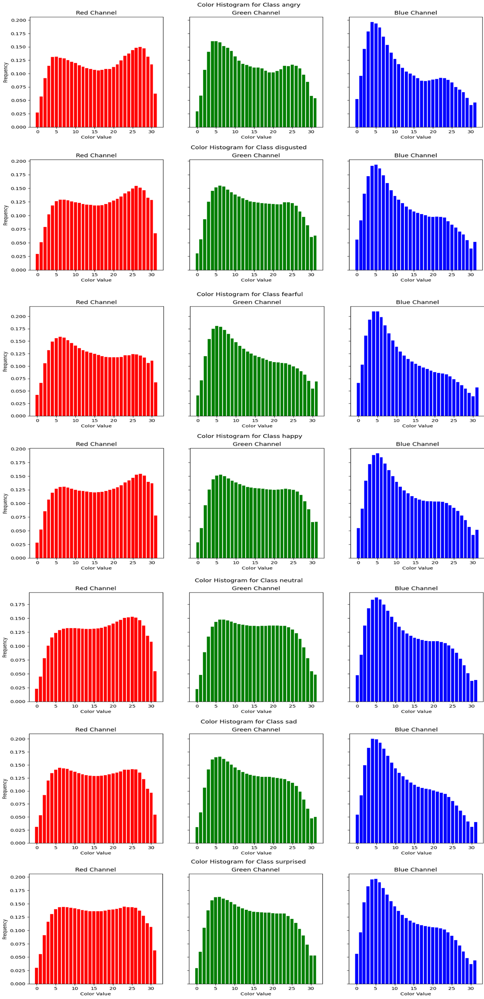

By plotting out the histogram of images from each classes, we notice that there's not much difference between classes, which means there's not much features in different classes for our model to learn. However, in order to let the process run smoothly, we will compare the highest pred_prob, and take the top 3 as outputs. 

## Print out probabilities for all classes

In [ ]:
NOISE_DIM = 128

model_folder = 'smaller_generator_70eps'   # Saved model folder
specific_label = 'happy'       # custom label
generated_images = load_and_generate_images_with_specific_label(model_folder, 16, NOISE_DIM, specific_label, label_encoder)

generated_images_array = np.array(generated_images)

generated_images_tensor = torch.tensor(generated_images_array, dtype=torch.float32)
generated_images_tensor = generated_images_tensor.permute(0, 3, 1, 2)

Update labels 

In [ ]:
label_encoder_original = LabelEncoder()
encoded_labels_original = label_encoder_original.fit_transform(df['emotion'])
class_name_dict_original = {i: class_name for i, class_name in enumerate(label_encoder_original.classes_)}

class_name_dict_original

{0: 'amusement',
 1: 'anger',
 2: 'awe',
 3: 'contentment',
 4: 'disgust',
 5: 'excitement',
 6: 'fear',
 7: 'sadness',
 8: 'something else'}

In [ ]:
# Update `artemis` model's label for our cases
class_name_dict_original.update(labels_mapping)
class_name_dict_original

{0: 'happy',
 1: 'angry',
 2: 'surprised',
 3: 'neutral',
 4: 'disgusted',
 5: 'happy',
 6: 'fearful',
 7: 'sad',
 8: 'neutral'}

In [ ]:
# Chekc pred_prob for each class for our generated images
import torch
from torch.nn.functional import softmax

artemis_model.eval()

with torch.no_grad():
    predictions = artemis_model(generated_images_tensor)
    
    # Apply softmax to obtain probabilities
    probabilities = softmax(predictions, dim=1)

    # Iterate over each image's probabilities and print them with the class names
    for i, image_probs in enumerate(probabilities):
        print(f"Image {i + 1}:")
        for class_id, class_name in class_name_dict_original.items():
            print(f"{class_name}: {image_probs[class_id].item():.4f}")
        print()

Image 1:
happy: 0.0531
angry: 0.1316
surprised: 0.4041
neutral: 0.0364
disgusted: 0.0067
happy: 0.0328
fearful: 0.0547
sad: 0.1445
neutral: 0.1361

Image 2:
happy: 0.0468
angry: 0.1531
surprised: 0.3682
neutral: 0.0485
disgusted: 0.0075
happy: 0.0382
fearful: 0.0647
sad: 0.1209
neutral: 0.1521

Image 3:
happy: 0.0697
angry: 0.1288
surprised: 0.2429
neutral: 0.0518
disgusted: 0.0128
happy: 0.0621
fearful: 0.1493
sad: 0.1199
neutral: 0.1628

Image 4:
happy: 0.0339
angry: 0.1615
surprised: 0.4158
neutral: 0.0457
disgusted: 0.0052
happy: 0.0281
fearful: 0.0530
sad: 0.1391
neutral: 0.1176

Image 5:
happy: 0.0308
angry: 0.2153
surprised: 0.4373
neutral: 0.0459
disgusted: 0.0046
happy: 0.0208
fearful: 0.0300
sad: 0.1136
neutral: 0.1018

Image 6:
happy: 0.0348
angry: 0.1718
surprised: 0.4095
neutral: 0.0407
disgusted: 0.0064
happy: 0.0265
fearful: 0.0400
sad: 0.1375
neutral: 0.1328

Image 7:
happy: 0.0705
angry: 0.1594
surprised: 0.2984
neutral: 0.0452
disgusted: 0.0091
happy: 0.0557
fearful: 

## Only takes the highest pred_prob from the input class

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import torch
from torch.nn.functional import softmax
scale_factor = 5

def group_duplicate_classes(labels_mapping):
    grouped_classes = {}
    for encoded_label, class_name in labels_mapping.items():
        if class_name not in grouped_classes:
            grouped_classes[class_name] = [encoded_label]
        else:
            grouped_classes[class_name].append(encoded_label)
    return grouped_classes

def upscale_image(image, scale_factor):
    return cv2.resize(image, None, fx=scale_factor, fy=scale_factor, interpolation=cv2.INTER_CUBIC)


def save_upscaled_images(upscaled_images, folder_name='saved_images'):
    if not os.path.exists(folder_name):
        os.makedirs(folder_name)

    for i, image in enumerate(upscaled_images):
        normalized_image = (image * 255).astype(np.uint8)
        file_name = os.path.join(folder_name, f"upscaled_image_{i}.png")
        cv2.imwrite(file_name, cv2.cvtColor(normalized_image, cv2.COLOR_RGB2BGR))

def plot_generated_images_with_predictions(model_folder, artemis_model, num_examples, noise_dim, class_name, label_encoder, labels_mapping, scale_factor=scale_factor):
    # Load and generate images with a specific label
    generated_images = load_and_generate_images_with_specific_label(model_folder, num_examples, noise_dim, class_name, label_encoder)

    # Prepare images for prediction
    generated_images = generated_images.numpy()
    generated_images_tensor = torch.from_numpy(generated_images).permute(0, 3, 1, 2)

    # Predict labels using the artemis_model
    predicted_classes = artemis_model(generated_images_tensor)
    pred_probs = softmax(predicted_classes, dim=1).detach().numpy()

    # Decode predicted labels
    decoded_predictions = [labels_mapping[predicted_class.item()] for predicted_class in torch.argmax(predicted_classes, dim=1)]

    # Group duplicate class names with their corresponding encoded labels
    grouped_classes = group_duplicate_classes(labels_mapping)

    # Calculate the combined probabilities for the specified class_name
    combined_probs = np.sum(pred_probs[:, grouped_classes[class_name]], axis=1)

    # Sort images and probabilities based on the combined_probs
    sorted_indices = np.argsort(combined_probs)[::-1]
    sorted_images = generated_images[sorted_indices][:3]  # Select the top 3 images
    sorted_pred_probs = combined_probs[sorted_indices][:3]  # Select the top 3 probabilities

    # Upscale the images
    upscaled_images = [upscale_image(image, scale_factor) for image in sorted_images]
    save_upscaled_images(upscaled_images)
    # Plot the generated images with input and predicted labels
    plt.figure(figsize=(10, 10))
    for i, (image, predicted_label, prob) in enumerate(zip(upscaled_images, decoded_predictions, sorted_pred_probs)):
        plt.subplot(4, 4, i + 1)
        plt.imshow(image, aspect='auto')
        plt.title(f"Input: {class_name}\nProb: {prob:.4f}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()
    
    return upscaled_images

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


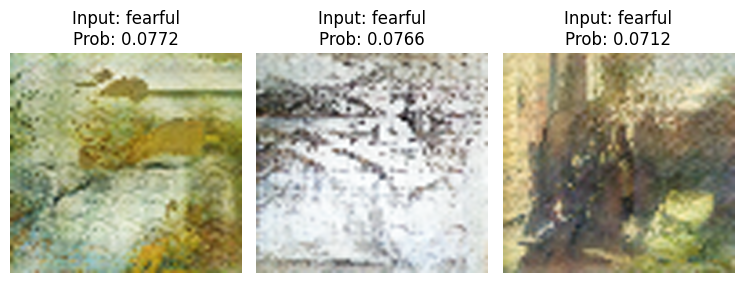

In [ ]:
model_folder = 'smaller_generator_70eps'   # Change to saved model folder
specific_label = 'fearful'       # Choose a label
top3_images = plot_generated_images_with_predictions(model_folder,artemis_model, 16, NOISE_DIM, specific_label, label_encoder, labels_mapping, scale_factor)

In [ ]:
top3_images

[array([[[0.53686166, 0.64097095, 0.52038485],
         [0.53932124, 0.6428503 , 0.5221278 ],
         [0.55899775, 0.65788513, 0.536071  ],
         ...,
         [0.61153674, 0.5631681 , 0.29611298],
         [0.60805726, 0.5597571 , 0.29579473],
         [0.6076222 , 0.55933076, 0.2957549 ]],
 
        [[0.5377386 , 0.641757  , 0.5209587 ],
         [0.5401771 , 0.6436226 , 0.52269113],
         [0.5596852 , 0.6585481 , 0.5365502 ],
         ...,
         [0.61134213, 0.56329024, 0.29605442],
         [0.60791737, 0.5599325 , 0.29577014],
         [0.6074892 , 0.5595128 , 0.29573458]],
 
        [[0.5447542 , 0.6480451 , 0.52554977],
         [0.5470242 , 0.6498014 , 0.527198  ],
         [0.56518406, 0.66385174, 0.5403839 ],
         ...,
         [0.6097856 , 0.56426734, 0.29558605],
         [0.6067991 , 0.56133556, 0.29557362],
         [0.60642576, 0.5609691 , 0.29557204]],
 
        ...,
 
        [[0.62860084, 0.6634411 , 0.5002606 ],
         [0.6285242 , 0.6638185 , 0.50117

## Upscale, denoise and save the best images by using Real-ESRGAN

In [ ]:
# Clone Real-ESRGAN and enter the Real-ESRGAN
# !git clone https://github.com/xinntao/Real-ESRGAN.git
%cd Real-ESRGAN
# Set up the environment
# !pip install basicsr
# !pip install facexlib
# !pip install gfpgan
# !pip install -r ./Real-ESRGAN/requirements.txt
!python setup.py develop

C:\Users\lzhan\Downloads\cGAN\Real-ESRGAN
running develop
running egg_info
writing realesrgan.egg-info\PKG-INFO
writing dependency_links to realesrgan.egg-info\dependency_links.txt
writing requirements to realesrgan.egg-info\requires.txt
writing top-level names to realesrgan.egg-info\top_level.txt
reading manifest file 'realesrgan.egg-info\SOURCES.txt'
reading manifest template 'MANIFEST.in'
adding license file 'LICENSE'
writing manifest file 'realesrgan.egg-info\SOURCES.txt'
running build_ext
Creating c:\users\lzhan\miniconda3\envs\tf\lib\site-packages\realesrgan.egg-link (link to .)
realesrgan 0.3.0 is already the active version in easy-install.pth

Installed c:\users\lzhan\downloads\cgan\real-esrgan
Processing dependencies for realesrgan==0.3.0
Searching for tqdm==4.65.0
Best match: tqdm 4.65.0
Adding tqdm 4.65.0 to easy-install.pth file
Installing tqdm-script.py script to C:\Users\lzhan\miniconda3\envs\tf\Scripts
Installing tqdm.exe script to C:\Users\lzhan\miniconda3\envs\tf\Scrip

C:\Users\lzhan\miniconda3\envs\tf\lib\site-packages\setuptools\installer.py:27: SetuptoolsDeprecationWarning: setuptools.installer is deprecated. Requirements should be satisfied by a PEP 517 installer.
  warnings.warn(
C:\Users\lzhan\miniconda3\envs\tf\lib\site-packages\setuptools\command\easy_install.py:144: EasyInstallDeprecationWarning: easy_install command is deprecated. Use build and pip and other standards-based tools.
  warnings.warn(
C:\Users\lzhan\miniconda3\envs\tf\lib\site-packages\setuptools\command\install.py:34: SetuptoolsDeprecationWarning: setup.py install is deprecated. Use build and pip and other standards-based tools.
  warnings.warn(


In [ ]:
import shutil

upload_folder = 'upload'
result_folder = 'results'

if os.path.isdir(upload_folder):
    shutil.rmtree(upload_folder)
if os.path.isdir(result_folder):
    shutil.rmtree(result_folder)
os.mkdir(upload_folder)
os.mkdir(result_folder)

Move generated image into upload folder

In [ ]:
%cd

C:\Users\lzhan


In [ ]:
for i in range(3):
    src_path = f"/Users/lzhan/Downloads/cGAN/saved_images/upscaled_image_{i}.png"
    dst_path = f"/Users/lzhan/Downloads/cGAN/Real-ESRGAN/upload/upscaled_image_{i}.png"
    shutil.move(src_path, dst_path)

In [ ]:
%cd /Users/lzhan/Downloads/cGAN/Real-ESRGAN

C:\Users\lzhan\Downloads\cGAN\Real-ESRGAN


In [ ]:
!python inference_realesrgan.py -n RealESRGAN_x4plus -i upload --outscale 3.5 --face_enhance

Testing 0 upscaled_image_0
Error "slow_conv2d_cpu" not implemented for 'Half'
If you encounter CUDA out of memory, try to set --tile with a smaller number.
Testing 1 upscaled_image_1
Error "slow_conv2d_cpu" not implemented for 'Half'
If you encounter CUDA out of memory, try to set --tile with a smaller number.
Testing 2 upscaled_image_2
Error "slow_conv2d_cpu" not implemented for 'Half'
If you encounter CUDA out of memory, try to set --tile with a smaller number.


C:\Users\lzhan\miniconda3\envs\tf\lib\site-packages\torchvision\transforms\functional_tensor.py:5: UserWarning: The torchvision.transforms.functional_tensor module is deprecated in 0.15 and will be **removed in 0.17**. Please don't rely on it. You probably just need to use APIs in torchvision.transforms.functional or in torchvision.transforms.v2.functional.
  warnings.warn(
C:\Users\lzhan\miniconda3\envs\tf\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\lzhan\miniconda3\envs\tf\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


Seems like my gpu-ram is not capable to run the denoising model. We will run it in our demo

In [ ]:
# utils for visualization
import cv2
import matplotlib.pyplot as plt
def display(img1, img2):
  fig = plt.figure(figsize=(25, 10))
  ax1 = fig.add_subplot(1, 2, 1) 
  plt.title('Input image', fontsize=16)
  ax1.axis('off')
  ax2 = fig.add_subplot(1, 2, 2)
  plt.title('Real-ESRGAN output', fontsize=16)
  ax2.axis('off')
  ax1.imshow(img1)
  ax2.imshow(img2)
def imread(img_path):
  img = cv2.imread(img_path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  return img

# display each image in the upload folder
import os
import glob

input_folder = 'upload'
result_folder = 'results'
input_list = sorted(glob.glob(os.path.join(input_folder, '*')))
output_list = sorted(glob.glob(os.path.join(result_folder, '*')))
for input_path, output_path in zip(input_list, output_list):
  img_input = imread(input_path)
  img_output = imread(output_path)
  display(img_input, img_output)